<a href="https://colab.research.google.com/github/Alan240124/Alan/blob/main/Tensor_board.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [15]:
import os
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

class HeartDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])

        image = Image.open(image_path).convert("L")  # Converter para grayscale
        mask = Image.open(mask_path).convert("L")    # Converter para grayscale

        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask


# Diretórios das imagens e máscaras
image_dir = '/content/drive/MyDrive/Coracao_DataSet/images'  # Substitua pelo caminho real
mask_dir = '/content/drive/MyDrive/Coracao_DataSet/masks'    # Substitua pelo caminho real

# Transformação (exemplo: converter para tensor)
#transform = transforms.ToTensor()
# Transforma as imagens para tensor e normaliza
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Redimensione conforme necessário
    transforms.ToTensor(),
])

# Criação do dataset e do DataLoader
dataset = HeartDataset(image_dir, mask_dir, transform=transform)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True)

# Exibir algumas informações do dataset
print(f"Total de imagens no dataset: {len(dataset)}")

# Exemplo de iteração pelo DataLoader
for images, masks in dataloader:
    print(f"Tamanho do batch de imagens: {images.shape}")
    print(f"Tamanho do batch de máscaras: {masks.shape}")
    break  # Apenas um batch para demonstração

Total de imagens no dataset: 8
Tamanho do batch de imagens: torch.Size([4, 1, 256, 256])
Tamanho do batch de máscaras: torch.Size([4, 1, 256, 256])


In [16]:
import torch.nn as nn
import torch

class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        def conv_block(in_channels, out_channels):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
                nn.ReLU(inplace=True)
            )

        self.encoder1 = conv_block(1, 64)
        self.pool1 = nn.MaxPool2d(2)
        self.encoder2 = conv_block(64, 128)
        self.pool2 = nn.MaxPool2d(2)
        self.encoder3 = conv_block(128, 256)
        self.pool3 = nn.MaxPool2d(2)
        self.encoder4 = conv_block(256, 512)
        self.pool4 = nn.MaxPool2d(2)

        self.bottleneck = conv_block(512, 1024)

        self.upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.decoder4 = conv_block(1024, 512)
        self.upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.decoder3 = conv_block(512, 256)
        self.upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder2 = conv_block(256, 128)
        self.upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder1 = conv_block(128, 64)

        self.conv_last = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x):
        e1 = self.encoder1(x)
        e2 = self.encoder2(self.pool1(e1))
        e3 = self.encoder3(self.pool2(e2))
        e4 = self.encoder4(self.pool3(e3))

        b = self.bottleneck(self.pool4(e4))

        d4 = self.upconv4(b)
        d4 = torch.cat((d4, e4), dim=1)
        d4 = self.decoder4(d4)
        d3 = self.upconv3(d4)
        d3 = torch.cat((d3, e3), dim=1)
        d3 = self.decoder3(d3)
        d2 = self.upconv2(d3)
        d2 = torch.cat((d2, e2), dim=1)
        d2 = self.decoder2(d2)
        d1 = self.upconv1(d2)
        d1 = torch.cat((d1, e1), dim=1)
        d1 = self.decoder1(d1)

        return torch.sigmoid(self.conv_last(d1))

# Inicializar o modelo e definir o otimizador e a função de perda
model = UNet()
criterion = nn.BCELoss()  # Usamos BCELoss para segmentação binária
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


In [17]:
# Configuração do dispositivo (GPU se disponível)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Loop de treinamento
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0
    for images, masks in dataloader:
        images = images.to(device)
        masks = masks.to(device)

        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, masks)

        # Backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss/len(dataloader)}")

    # Salva o modelo após cada epoch
    torch.save(model.state_dict(), f"unet_epoch_{epoch+1}.pth")

Epoch [1/10], Loss: 0.6699648797512054
Epoch [2/10], Loss: 0.6151135861873627
Epoch [3/10], Loss: 7.454261958599091
Epoch [4/10], Loss: 2.5842288732528687
Epoch [5/10], Loss: 0.43118883669376373
Epoch [6/10], Loss: 0.39841680228710175
Epoch [7/10], Loss: 0.29215213656425476
Epoch [8/10], Loss: 0.19747808575630188
Epoch [9/10], Loss: 0.13956544548273087
Epoch [10/10], Loss: 0.10570403933525085


In [18]:
import torch

# Configuração do dispositivo (GPU se disponível)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Loop de treinamento
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0
    for images, masks in dataloader:
        # Movendo dados para o dispositivo
        images = images.to(device)
        masks = masks.to(device)

        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, masks)

        # Backward pass e otimização
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Acumulando a perda para monitoramento
        epoch_loss += loss.item()

    # Exibindo a perda média por epoch
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss / len(dataloader)}")

    # Salvando o modelo após cada epoch
    torch.save(model.state_dict(), f"unet_epoch_{epoch+1}.pth")

# Função para calcular o coeficiente DICE
def dice_coefficient(pred, target, epsilon=1e-6):
    intersection = (pred * target).sum()
    return (2. * intersection + epsilon) / (pred.sum() + target.sum() + epsilon)

# Avaliação com uma batch do DataLoader
model.eval()
with torch.no_grad():
    for images, masks in dataloader:
        images = images.to(device)
        masks = masks.to(device)

        # Predições do modelo
        outputs = model(images)

        # Cálculo do coeficiente DICE
        dice = dice_coefficient(outputs, masks)
        print("DICE coefficient:", dice.item())
        break  # Apenas para a primeira batch


Epoch [1/10], Loss: 0.09602606296539307
Epoch [2/10], Loss: 0.093437809497118
Epoch [3/10], Loss: 0.09093715623021126
Epoch [4/10], Loss: 0.08696048334240913
Epoch [5/10], Loss: 3.8969936184585094
Epoch [6/10], Loss: 0.10979240387678146
Epoch [7/10], Loss: 0.09390998631715775
Epoch [8/10], Loss: 0.09624704718589783
Epoch [9/10], Loss: 0.09258491918444633
Epoch [10/10], Loss: 0.08890612795948982
DICE coefficient: 0.8256714940071106


In [19]:
def dice_coefficient(pred, target, epsilon=1e-6):
    intersection = (pred * target).sum()
    return (2. * intersection + epsilon) / (pred.sum() + target.sum() + epsilon)

# Exemplo de uso com uma batch do DataLoader
model.eval()
with torch.no_grad():
    for images, masks in dataloader:
        images = images.to(device)
        masks = masks.to(device)

        outputs = model(images)
        dice = dice_coefficient(outputs, masks)
        print("DICE coefficient:", dice.item())
        break  # Apenas para uma batch

DICE coefficient: 0.8358737826347351


In [20]:
import torch
import numpy as np

# Função de cálculo do DICE coefficient
def dice_coefficient(pred, target, epsilon=1e-6):
    pred = (pred > 0.5).float()  # Binarizar a predição
    target = (target > 0.5).float()  # Binarizar a máscara
    intersection = (pred * target).sum()  # Calcular a interseção
    return (2. * intersection + epsilon) / (pred.sum() + target.sum() + epsilon)  # Fórmula do DICE

# Função de cálculo da Intersection over Union (IoU)
def iou_score(pred, target, epsilon=1e-6):
    pred = (pred > 0.5).float()
    target = (target > 0.5).float()
    intersection = (pred * target).sum()  # Interseção
    union = pred.sum() + target.sum() - intersection  # União
    return (intersection + epsilon) / (union + epsilon)  # Fórmula do IoU

# Função de cálculo da Accuracy
def accuracy_score(pred, target):
    pred = (pred > 0.5).float()  # Binarizar a predição
    target = (target > 0.5).float()  # Binarizar a máscara
    correct = (pred == target).sum()  # Contar acertos
    total = target.numel()  # Total de pixels
    return correct / total  # Proporção de acertos

# Exemplo de uso com uma batch do DataLoader
model.eval()  # Coloca o modelo em modo de avaliação
with torch.no_grad():  # Desliga o cálculo de gradientes
    for images, masks in dataloader:  # Loop sobre as batches
        images = images.to(device)  # Mover para o dispositivo (GPU ou CPU)
        masks = masks.to(device)

        # Passando as imagens pela rede
        outputs = model(images)

        # Calcular as métricas
        dice = dice_coefficient(outputs, masks)  # DICE coefficient
        iou = iou_score(outputs, masks)  # IoU
        accuracy = accuracy_score(outputs, masks)  # Accuracy

        # Exibindo os resultados
        print(f"DICE coefficient: {dice.item():.4f}")
        print(f"IoU score: {iou.item():.4f}")
        print(f"Accuracy: {accuracy.item():.4f}")

        break  # Apenas para uma batch, remova esta linha para calcular para todas as batches


DICE coefficient: 0.9240
IoU score: 0.8587
Accuracy: 0.9744


In [21]:
import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import os
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.metrics import MeanIoU

# Função para carregar o dataset
def load_data(images_path, masks_path, img_size=(128, 128)):
    images = []
    masks = []

    for img_name in sorted(os.listdir(images_path)):
        img = tf.keras.preprocessing.image.load_img(os.path.join(images_path, img_name), target_size=img_size)
        img = tf.keras.preprocessing.image.img_to_array(img) / 255.0
        images.append(img)

    for mask_name in sorted(os.listdir(masks_path)):
        mask = tf.keras.preprocessing.image.load_img(os.path.join(masks_path, mask_name), color_mode='grayscale', target_size=img_size)
        mask = tf.keras.preprocessing.image.img_to_array(mask) / 255.0
        masks.append(mask)

    images = np.array(images, dtype=np.float32)
    masks = np.array(masks, dtype=np.float32)

    return train_test_split(images, masks, test_size=0.2, random_state=42)

# Função para definir o modelo CNN
def create_cnn_model(input_shape):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same', activation='relu'),
        layers.Conv2DTranspose(32, (3, 3), strides=(2, 2), padding='same', activation='relu'),
        layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', activation='sigmoid')
    ])
    return model

# Criar a métrica MeanIoU fora da função iou_metric
metric = MeanIoU(num_classes=2)

# Função de métrica personalizada (usando MeanIoU)
def iou_metric(y_true, y_pred):
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    metric.update_state(y_true, y_pred)
    return metric.result()

# Função para monitorar o treinamento
def get_callbacks():
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
    return [early_stopping]

# Função principal de treinamento
def main(images_path, masks_path):
    # Carregar dados
    X_train, X_val, y_train, y_val = load_data(images_path, masks_path)

    # Definir modelo
    input_shape = X_train.shape[1:]
    model = create_cnn_model(input_shape)

    # Compilar modelo
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[iou_metric])

    # Treinar modelo
    history = model.fit(X_train, y_train,
                        validation_data=(X_val, y_val),
                        epochs=50,
                        batch_size=8,
                        callbacks=get_callbacks())

    # Avaliar o modelo
    val_loss, val_iou = model.evaluate(X_val, y_val)
    print(f"Validation IoU: {val_iou:.4f}")

    return model, history

# Caminhos para as pastas de imagens e máscaras
images_path = '/content/drive/MyDrive/Coracao_DataSet/images'
masks_path = '/content/drive/MyDrive/Coracao_DataSet/masks'

# Executar o treinamento
if __name__ == "__main__":
    model, history = main(images_path, masks_path)


Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - iou_metric: 0.2806 - loss: 0.6933 - val_iou_metric: 0.3159 - val_loss: 0.6921
Epoch 2/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - iou_metric: 0.3620 - loss: 0.6921 - val_iou_metric: 0.3730 - val_loss: 0.6906
Epoch 3/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 835ms/step - iou_metric: 0.3954 - loss: 0.6906 - val_iou_metric: 0.4006 - val_loss: 0.6884
Epoch 4/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step - iou_metric: 0.4128 - loss: 0.6884 - val_iou_metric: 0.4154 - val_loss: 0.6848
Epoch 5/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step - iou_metric: 0.4221 - loss: 0.6849 - val_iou_metric: 0.4236 - val_loss: 0.6791
Epoch 6/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step - iou_metric: 0.4280 - loss: 0.6793 - val_iou_metric: 0.4288 - val_loss: 0.6705
Epoch 7/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step - iou_metric: 0.4314 - loss: 0.6708 - val_iou_metric: 0.4319 - val_loss: 0.6583
Epoch 8/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step - iou_metric: 0.4337 - loss: 0.6588 - val_iou_metric: 

Epoch 1/10


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.4193 - loss: 0.6931
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step - accuracy: 0.6852 - loss: 0.6906
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 799ms/step - accuracy: 0.6947 - loss: 0.6865
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 847ms/step - accuracy: 0.6911 - loss: 0.6799
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 828ms/step - accuracy: 0.6824 - loss: 0.6693
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.6865 - loss: 0.6506
Epoch 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.6911 - loss: 0.6251
Epoch 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 889ms/step - accuracy: 0.6948 - loss: 0.6172
Epoch 9/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step - accuracy: 0.6865 - loss: 0.6394
Epoch 10/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step - accuracy: 0.6845 - loss: 0.6180
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


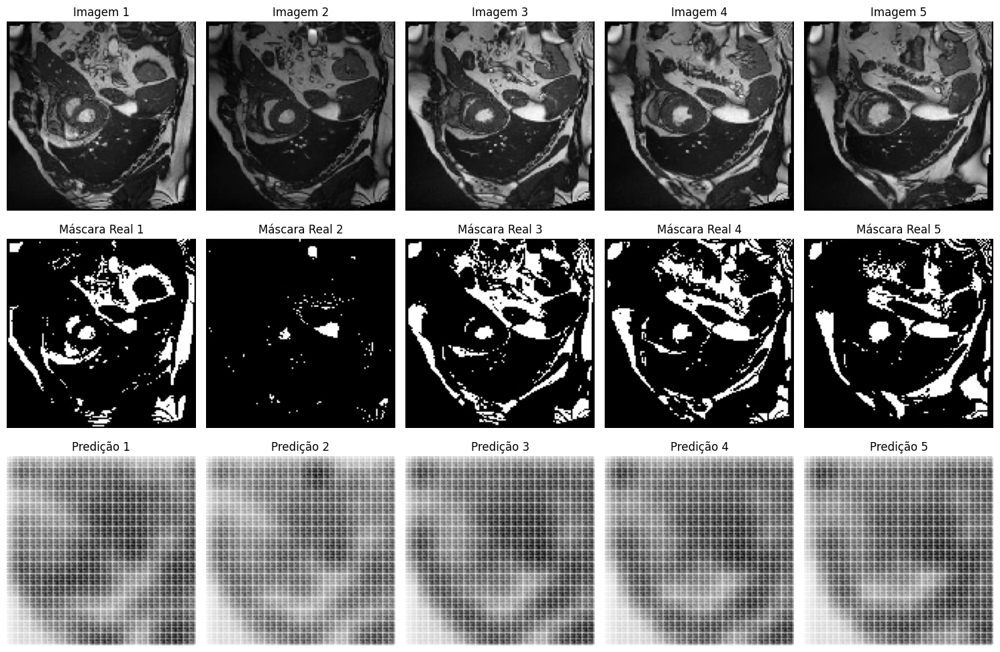

In [22]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.utils import Sequence
import matplotlib.pyplot as plt
from tensorflow.keras import layers, models

# Função para carregar e pré-processar as imagens e máscaras
def data(images_path, masks_path, img_size=(128, 128)):
    """
    Carrega e pré-processa as imagens e máscaras para segmentação.

    Parameters:
    - images_path: Caminho das imagens.
    - masks_path: Caminho das máscaras.
    - img_size: Tamanho de redimensionamento das imagens.

    Returns:
    - images: Numpy array com as imagens carregadas e normalizadas.
    - masks: Numpy array com as máscaras carregadas e normalizadas.
    """

    images = []
    masks = []

    for img_name in sorted(os.listdir(images_path)):
        # Carregar a imagem
        img = load_img(os.path.join(images_path, img_name), target_size=img_size)
        img = img_to_array(img) / 255.0  # Normalizar a imagem
        images.append(img)

    for mask_name in sorted(os.listdir(masks_path)):
        # Carregar a máscara
        mask = load_img(os.path.join(masks_path, mask_name), color_mode='grayscale', target_size=img_size)
        mask = img_to_array(mask) / 255.0  # Normalizar a máscara
        masks.append(mask)

    # Converter para numpy arrays
    images = np.array(images, dtype=np.float32)
    masks = np.array(masks, dtype=np.float32)

    # Adicionar a dimensão extra para a máscara (se necessário)
    if len(masks.shape) == 3:
        masks = np.expand_dims(masks, axis=-1)

    return images, masks

# DataLoader para carregar o dataset em lotes
class SegmentationDataLoader(Sequence):
    def __init__(self, images_path, masks_path, batch_size=8, img_size=(128, 128), shuffle=True):
        self.images_path = images_path
        self.masks_path = masks_path
        self.batch_size = batch_size
        self.img_size = img_size
        self.shuffle = shuffle

        self.images, self.masks = data(images_path, masks_path, img_size)
        self.indices = np.arange(len(self.images))
        self.on_epoch_end()  # Embaralhar os dados inicialmente

    def __len__(self):
        return int(np.floor(len(self.images) / self.batch_size))

    def __getitem__(self, index):
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        batch_images = self.images[batch_indices]
        batch_masks = self.masks[batch_indices]
        return batch_images, batch_masks

    def on_epoch_end(self):
        if self.shuffle:
            np.random.shuffle(self.indices)

# Função para definir o modelo CNN de segmentação
def create_cnn_model(input_shape):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        layers.MaxPooling2D((2, 2)),

        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2)),

        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2)),

        layers.Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same', activation='relu'),
        layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same', activation='relu'),
        layers.Conv2DTranspose(32, (3, 3), strides=(2, 2), padding='same', activation='relu'),

        layers.Conv2D(1, (1, 1), activation='sigmoid', padding='same')
    ])
    return model

# Função para treinar o modelo
def train_and_evaluate_model(images_path, masks_path, img_size=(128, 128), batch_size=8, epochs=50):
    # Criar o DataLoader
    train_loader = SegmentationDataLoader(images_path, masks_path, batch_size=batch_size, img_size=img_size)

    # Definir o modelo
    input_shape = (img_size[0], img_size[1], 3)  # 3 canais para RGB
    model = create_cnn_model(input_shape)

    # Compilar o modelo
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    # Treinamento
    history = model.fit(train_loader, epochs=epochs)

    return model, history

# Função para visualizar as previsões
def visualize_predictions(model, images_path, masks_path, img_size=(128, 128)):
    # Carregar as primeiras 5 imagens e máscaras
    images, masks = data(images_path, masks_path, img_size)

    # Prever as máscaras para as primeiras 5 imagens
    preds = model.predict(images[:5])

    plt.figure(figsize=(15, 10))

    for i in range(5):
        plt.subplot(3, 5, i+1)
        plt.imshow(images[i])
        plt.title(f"Imagem {i+1}")
        plt.axis('off')

        plt.subplot(3, 5, i+6)
        plt.imshow(masks[i].squeeze(), cmap='gray')
        plt.title(f"Máscara Real {i+1}")
        plt.axis('off')

        plt.subplot(3, 5, i+11)
        plt.imshow(preds[i].squeeze(), cmap='gray')
        plt.title(f"Predição {i+1}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Função principal para treinar, avaliar e visualizar o modelo
def main():
    # Caminhos para as pastas de imagens e máscaras
    images_path = '/content/drive/MyDrive/DataSet3/images'  # Substitua pelo caminho da sua pasta de imagens
    masks_path = '/content/drive/MyDrive/DataSet3/masks'    # Substitua pelo caminho da sua pasta de máscaras

    # Treinamento e avaliação
    model, history = train_and_evaluate_model(images_path, masks_path, img_size=(128, 128), batch_size=8, epochs=10)

    # Visualizar as previsões
    visualize_predictions(model, images_path, masks_path, img_size=(128, 128))

if __name__ == "__main__":
    main()


In [23]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm
from PIL import Image

# Caminho do dataset
dataset_path = '/content/drive/MyDrive/Coracao_DataSet'

# Dataset personalizado
class HeartSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")  # Máscaras em tons de cinza

        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        mask = (mask > 0).float()  # Binarização da máscara
        return image, mask

# Transforma imagens para tensor
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Tamanho fixo para imagens e máscaras
    transforms.ToTensor()
])

# Diretórios das imagens e máscaras
image_dir = os.path.join(dataset_path, 'images')
mask_dir = os.path.join(dataset_path, 'masks')

# Divisão do dataset
dataset = HeartSegmentationDataset(image_dir, mask_dir, transform=transform)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

# Dataloaders
batch_size = 4
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

dataloaders = {'train': train_dataloader, 'val': val_dataloader}

# Modelo U-Net Simplificado
class SimpleUNet(nn.Module):
    def __init__(self):
        super(SimpleUNet, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 1, kernel_size=2, stride=2),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Métricas de IoU e Dice
def iou_score(pred, target, smooth=1e-6):
    pred = (pred > 0.5).float()  # Binarizar predições
    intersection = (pred * target).sum((1, 2, 3))
    union = (pred + target).clamp(0, 1).sum((1, 2, 3))
    return ((intersection + smooth) / (union + smooth)).mean()

def dice_score(pred, target, smooth=1e-6):
    pred = (pred > 0.5).float()  # Binarizar predições
    intersection = (pred * target).sum((1, 2, 3))
    return ((2. * intersection + smooth) / (pred.sum((1, 2, 3)) + target.sum((1, 2, 3)) + smooth)).mean()

# Função de Treinamento
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25, patience=5):
    best_model_wts = model.state_dict()
    best_loss = float('inf')
    early_stop_counter = 0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_iou = 0.0
            running_dice = 0.0

            for inputs, masks in tqdm(dataloaders[phase]):
                inputs, masks = inputs.to(device), masks.to(device)
                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    outputs = F.interpolate(outputs, size=masks.shape[2:], mode='bilinear', align_corners=False)
                    loss = criterion(outputs, masks)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                running_iou += iou_score(outputs, masks).item() * inputs.size(0)
                running_dice += dice_score(outputs, masks).item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_iou = running_iou / len(dataloaders[phase].dataset)
            epoch_dice = running_dice / len(dataloaders[phase].dataset)

            print(f'{phase} Loss: {epoch_loss:.4f} IoU: {epoch_iou:.4f} Dice: {epoch_dice:.4f}')

            if phase == 'val':
                scheduler.step(epoch_loss)

                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    best_model_wts = model.state_dict()
                    early_stop_counter = 0
                else:
                    early_stop_counter += 1

        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

    model.load_state_dict(best_model_wts)
    return model

# Configurações do modelo e treinamento
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = SimpleUNet().to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model.parameters(), lr=1e-3)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)

# Treinar o modelo
model = train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=50, patience=7)


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 0/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.04it/s]


train Loss: 0.8581 IoU: 0.2865 Dice: 0.4447


100%|██████████| 1/1 [00:00<00:00,  3.97it/s]


val Loss: 0.8491 IoU: 0.2936 Dice: 0.4521
Epoch 1/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.01s/it]


train Loss: 0.8521 IoU: 0.2865 Dice: 0.4447


100%|██████████| 1/1 [00:00<00:00,  2.76it/s]


val Loss: 0.8425 IoU: 0.2930 Dice: 0.4513
Epoch 2/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.20s/it]


train Loss: 0.8449 IoU: 0.2909 Dice: 0.4497


100%|██████████| 1/1 [00:00<00:00,  2.59it/s]


val Loss: 0.8335 IoU: 0.3216 Dice: 0.4845
Epoch 3/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.15s/it]


train Loss: 0.8351 IoU: 0.3169 Dice: 0.4806


100%|██████████| 1/1 [00:00<00:00,  4.08it/s]


val Loss: 0.8210 IoU: 0.3393 Dice: 0.5041
Epoch 4/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.25it/s]


train Loss: 0.8215 IoU: 0.3641 Dice: 0.5327


100%|██████████| 1/1 [00:00<00:00,  4.09it/s]


val Loss: 0.8047 IoU: 0.4390 Dice: 0.6072
Epoch 5/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


train Loss: 0.8042 IoU: 0.4711 Dice: 0.6385


100%|██████████| 1/1 [00:00<00:00,  3.95it/s]


val Loss: 0.7845 IoU: 0.5115 Dice: 0.6738
Epoch 6/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


train Loss: 0.7828 IoU: 0.5406 Dice: 0.7009


100%|██████████| 1/1 [00:00<00:00,  3.87it/s]


val Loss: 0.7608 IoU: 0.5562 Dice: 0.7120
Epoch 7/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


train Loss: 0.7579 IoU: 0.5928 Dice: 0.7434


100%|██████████| 1/1 [00:00<00:00,  3.93it/s]


val Loss: 0.7349 IoU: 0.5584 Dice: 0.7135
Epoch 8/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.24it/s]


train Loss: 0.7312 IoU: 0.5987 Dice: 0.7480


100%|██████████| 1/1 [00:00<00:00,  3.49it/s]


val Loss: 0.7092 IoU: 0.5515 Dice: 0.7073
Epoch 9/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.21s/it]


train Loss: 0.7050 IoU: 0.5937 Dice: 0.7438


100%|██████████| 1/1 [00:00<00:00,  2.62it/s]


val Loss: 0.6860 IoU: 0.5421 Dice: 0.6989
Epoch 10/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.29s/it]


train Loss: 0.6820 IoU: 0.5888 Dice: 0.7397


100%|██████████| 1/1 [00:00<00:00,  2.31it/s]


val Loss: 0.6674 IoU: 0.5621 Dice: 0.7162
Epoch 11/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.16s/it]


train Loss: 0.6638 IoU: 0.6042 Dice: 0.7521


100%|██████████| 1/1 [00:00<00:00,  4.03it/s]


val Loss: 0.6547 IoU: 0.5785 Dice: 0.7300
Epoch 12/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.24it/s]


train Loss: 0.6513 IoU: 0.6200 Dice: 0.7643


100%|██████████| 1/1 [00:00<00:00,  3.97it/s]


val Loss: 0.6466 IoU: 0.5590 Dice: 0.7134
Epoch 13/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.20it/s]


train Loss: 0.6438 IoU: 0.5975 Dice: 0.7470


100%|██████████| 1/1 [00:00<00:00,  4.02it/s]


val Loss: 0.6419 IoU: 0.5630 Dice: 0.7169
Epoch 14/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


train Loss: 0.6391 IoU: 0.6137 Dice: 0.7597


100%|██████████| 1/1 [00:00<00:00,  3.83it/s]


val Loss: 0.6399 IoU: 0.5944 Dice: 0.7430
Epoch 15/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


train Loss: 0.6370 IoU: 0.6309 Dice: 0.7728


100%|██████████| 1/1 [00:00<00:00,  3.84it/s]


val Loss: 0.6375 IoU: 0.5654 Dice: 0.7188
Epoch 16/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.03it/s]


train Loss: 0.6350 IoU: 0.6078 Dice: 0.7549


100%|██████████| 1/1 [00:00<00:00,  2.67it/s]


val Loss: 0.6363 IoU: 0.5690 Dice: 0.7219
Epoch 17/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.22s/it]


train Loss: 0.6339 IoU: 0.6142 Dice: 0.7599


100%|██████████| 1/1 [00:00<00:00,  2.62it/s]


val Loss: 0.6357 IoU: 0.5897 Dice: 0.7390
Epoch 18/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.34s/it]


train Loss: 0.6331 IoU: 0.6285 Dice: 0.7709


100%|██████████| 1/1 [00:00<00:00,  3.32it/s]


val Loss: 0.6349 IoU: 0.5729 Dice: 0.7250
Epoch 19/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.27it/s]


train Loss: 0.6326 IoU: 0.6147 Dice: 0.7603


100%|██████████| 1/1 [00:00<00:00,  3.91it/s]


val Loss: 0.6344 IoU: 0.5825 Dice: 0.7330
Epoch 20/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


train Loss: 0.6320 IoU: 0.6263 Dice: 0.7692


100%|██████████| 1/1 [00:00<00:00,  3.77it/s]


val Loss: 0.6342 IoU: 0.5906 Dice: 0.7397
Epoch 21/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


train Loss: 0.6317 IoU: 0.6293 Dice: 0.7717


100%|██████████| 1/1 [00:00<00:00,  3.72it/s]


val Loss: 0.6338 IoU: 0.5747 Dice: 0.7264
Epoch 22/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.26it/s]


train Loss: 0.6314 IoU: 0.6180 Dice: 0.7628


100%|██████████| 1/1 [00:00<00:00,  3.93it/s]


val Loss: 0.6337 IoU: 0.5955 Dice: 0.7438
Epoch 23/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.24it/s]


train Loss: 0.6313 IoU: 0.6379 Dice: 0.7781


100%|██████████| 1/1 [00:00<00:00,  3.77it/s]


val Loss: 0.6331 IoU: 0.5841 Dice: 0.7342
Epoch 24/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.25s/it]


train Loss: 0.6308 IoU: 0.6252 Dice: 0.7685


100%|██████████| 1/1 [00:00<00:00,  2.38it/s]


val Loss: 0.6332 IoU: 0.5707 Dice: 0.7229
Epoch 25/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.34s/it]


train Loss: 0.6308 IoU: 0.6198 Dice: 0.7642


100%|██████████| 1/1 [00:00<00:00,  2.27it/s]


val Loss: 0.6329 IoU: 0.5984 Dice: 0.7460
Epoch 26/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.26s/it]


train Loss: 0.6306 IoU: 0.6386 Dice: 0.7787


100%|██████████| 1/1 [00:00<00:00,  3.54it/s]


val Loss: 0.6325 IoU: 0.5844 Dice: 0.7343
Epoch 27/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.10it/s]


train Loss: 0.6303 IoU: 0.6268 Dice: 0.7696


100%|██████████| 1/1 [00:00<00:00,  3.16it/s]


val Loss: 0.6324 IoU: 0.5949 Dice: 0.7429
Epoch 28/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.11it/s]


train Loss: 0.6301 IoU: 0.6382 Dice: 0.7783


100%|██████████| 1/1 [00:00<00:00,  3.40it/s]


val Loss: 0.6322 IoU: 0.5938 Dice: 0.7420
Epoch 29/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.10it/s]


train Loss: 0.6299 IoU: 0.6347 Dice: 0.7757


100%|██████████| 1/1 [00:00<00:00,  3.31it/s]


val Loss: 0.6321 IoU: 0.5845 Dice: 0.7343
Epoch 30/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.11it/s]


train Loss: 0.6300 IoU: 0.6297 Dice: 0.7718


100%|██████████| 1/1 [00:00<00:00,  3.29it/s]


val Loss: 0.6319 IoU: 0.5963 Dice: 0.7439
Epoch 31/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.22s/it]


train Loss: 0.6298 IoU: 0.6353 Dice: 0.7760


100%|██████████| 1/1 [00:00<00:00,  2.30it/s]


val Loss: 0.6318 IoU: 0.5987 Dice: 0.7460
Epoch 32/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.39s/it]


train Loss: 0.6298 IoU: 0.6412 Dice: 0.7805


100%|██████████| 1/1 [00:00<00:00,  2.12it/s]


val Loss: 0.6317 IoU: 0.5884 Dice: 0.7375
Epoch 33/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.24s/it]


train Loss: 0.6297 IoU: 0.6281 Dice: 0.7707


100%|██████████| 1/1 [00:00<00:00,  3.48it/s]


val Loss: 0.6316 IoU: 0.5962 Dice: 0.7438
Epoch 34/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.09it/s]


train Loss: 0.6294 IoU: 0.6412 Dice: 0.7806


100%|██████████| 1/1 [00:00<00:00,  3.53it/s]


val Loss: 0.6320 IoU: 0.6160 Dice: 0.7601
Epoch 35/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.08it/s]


train Loss: 0.6297 IoU: 0.6475 Dice: 0.7855


100%|██████████| 1/1 [00:00<00:00,  3.40it/s]


val Loss: 0.6315 IoU: 0.5888 Dice: 0.7377
Epoch 36/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.09it/s]


train Loss: 0.6294 IoU: 0.6318 Dice: 0.7735


100%|██████████| 1/1 [00:00<00:00,  3.53it/s]


val Loss: 0.6316 IoU: 0.6132 Dice: 0.7579
Epoch 37/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.07it/s]


train Loss: 0.6294 IoU: 0.6493 Dice: 0.7867


100%|██████████| 1/1 [00:00<00:00,  3.46it/s]


val Loss: 0.6313 IoU: 0.6072 Dice: 0.7528
Epoch 38/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.26s/it]


train Loss: 0.6292 IoU: 0.6420 Dice: 0.7810


100%|██████████| 1/1 [00:00<00:00,  2.38it/s]


val Loss: 0.6311 IoU: 0.6021 Dice: 0.7487
Epoch 39/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.40s/it]


train Loss: 0.6291 IoU: 0.6451 Dice: 0.7836


100%|██████████| 1/1 [00:00<00:00,  2.19it/s]


val Loss: 0.6311 IoU: 0.6051 Dice: 0.7512
Epoch 40/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.20s/it]


train Loss: 0.6289 IoU: 0.6440 Dice: 0.7827


100%|██████████| 1/1 [00:00<00:00,  3.38it/s]


val Loss: 0.6311 IoU: 0.5917 Dice: 0.7400
Epoch 41/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.10it/s]


train Loss: 0.6290 IoU: 0.6368 Dice: 0.7772


100%|██████████| 1/1 [00:00<00:00,  3.36it/s]


val Loss: 0.6312 IoU: 0.6167 Dice: 0.7605
Epoch 42/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.09it/s]


train Loss: 0.6290 IoU: 0.6527 Dice: 0.7892


100%|██████████| 1/1 [00:00<00:00,  3.40it/s]


val Loss: 0.6309 IoU: 0.6019 Dice: 0.7484
Epoch 43/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.11it/s]


train Loss: 0.6288 IoU: 0.6411 Dice: 0.7805


100%|██████████| 1/1 [00:00<00:00,  3.51it/s]


val Loss: 0.6308 IoU: 0.6004 Dice: 0.7473
Epoch 44/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.09it/s]


train Loss: 0.6288 IoU: 0.6421 Dice: 0.7812


100%|██████████| 1/1 [00:00<00:00,  3.39it/s]


val Loss: 0.6307 IoU: 0.6078 Dice: 0.7532
Epoch 45/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.24s/it]


train Loss: 0.6286 IoU: 0.6459 Dice: 0.7841


100%|██████████| 1/1 [00:00<00:00,  2.37it/s]


val Loss: 0.6307 IoU: 0.6016 Dice: 0.7482
Epoch 46/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.36s/it]


train Loss: 0.6286 IoU: 0.6421 Dice: 0.7812


100%|██████████| 1/1 [00:00<00:00,  2.21it/s]


val Loss: 0.6308 IoU: 0.6183 Dice: 0.7617
Epoch 47/49
----------


100%|██████████| 2/2 [00:02<00:00,  1.22s/it]


train Loss: 0.6287 IoU: 0.6526 Dice: 0.7892


100%|██████████| 1/1 [00:00<00:00,  3.38it/s]


val Loss: 0.6305 IoU: 0.6083 Dice: 0.7536
Epoch 48/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.09it/s]


train Loss: 0.6285 IoU: 0.6479 Dice: 0.7856


100%|██████████| 1/1 [00:00<00:00,  3.41it/s]


val Loss: 0.6306 IoU: 0.5993 Dice: 0.7462
Epoch 49/49
----------


100%|██████████| 2/2 [00:01<00:00,  1.10it/s]


train Loss: 0.6285 IoU: 0.6404 Dice: 0.7800


100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

val Loss: 0.6304 IoU: 0.6126 Dice: 0.7571


In [24]:
import os
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from tqdm import tqdm
from PIL import Image
import numpy as np

# Caminho do dataset
dataset_path = '/content/drive/MyDrive/Coracao_DataSet'

# Transformações para imagens e máscaras
image_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

mask_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

# Dataset personalizado
class HeartSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, image_transform=None, mask_transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_transform = image_transform
        self.mask_transform = mask_transform
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")  # Máscaras são em tons de cinza

        if self.image_transform:
            image = self.image_transform(image)
        if self.mask_transform:
            mask = self.mask_transform(mask)

        mask = (mask > 0).float()  # Binarização da máscara
        return image, mask

# Diretórios das imagens e máscaras
image_dir = os.path.join(dataset_path, 'images')
mask_dir = os.path.join(dataset_path, 'masks')

# Divisão do dataset
dataset = HeartSegmentationDataset(image_dir, mask_dir, image_transform, mask_transform)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

# Dataloaders
batch_size = 4
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

dataloaders = {'train': train_dataloader, 'val': val_dataloader}

# Modelo U-Net simples
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2),
            nn.ReLU(),
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Métricas: IoU e Dice
def iou_score(pred, target, smooth=1e-6):
    pred = pred > 0.5  # Converte para binário
    target = target > 0.5
    intersection = (pred & target).float().sum((1, 2, 3))  # Somar nas dimensões do batch
    union = (pred | target).float().sum((1, 2, 3))
    iou = (intersection + smooth) / (union + smooth)
    return iou.mean()  # Retorna um valor escalar

def dice_score(pred, target, smooth=1e-6):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred * target).float().sum((1, 2, 3))
    dice = (2 * intersection + smooth) / (pred.sum((1, 2, 3)) + target.sum((1, 2, 3)) + smooth)
    return dice.mean()

# Função de Treinamento com Parada Antecipada e Decaimento do Learning Rate
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25, patience=5):
    best_model_wts = model.state_dict()
    best_loss = float('inf')
    early_stop_counter = 0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_iou = 0.0
            running_dice = 0.0

            for inputs, masks in tqdm(dataloaders[phase]):
                inputs, masks = inputs.to(device), masks.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, masks)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                preds = torch.sigmoid(outputs) > 0.5
                running_loss += loss.item() * inputs.size(0)
                running_iou += iou_score(preds, masks).item() * inputs.size(0)
                running_dice += dice_score(preds, masks).item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_iou = running_iou / len(dataloaders[phase].dataset)
            epoch_dice = running_dice / len(dataloaders[phase].dataset)

            print(f'{phase} Loss: {epoch_loss:.4f} IoU: {epoch_iou:.4f} Dice: {epoch_dice:.4f}')

            # Estratégia de parada automática
            if phase == 'val':
                scheduler.step(epoch_loss)

                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    best_model_wts = model.state_dict()
                    early_stop_counter = 0
                else:
                    early_stop_counter += 1

        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

    model.load_state_dict(best_model_wts)
    return model

# Configurações do modelo e treinamento
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCEWithLogitsLoss()  # Usando logits diretamente
optimizer = Adam(model.parameters(), lr=1e-3)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)

# Treinamento do modelo
model = train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=50, patience=7)

# Salvando o modelo treinado
torch.save(model.state_dict(), 'modelo_heart_segmentation.pth')


Epoch 0/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.21s/it]


train Loss: 0.8391 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.8027 IoU: 0.3384 Dice: 0.5057
Epoch 1/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.35s/it]


train Loss: 0.8348 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


val Loss: 0.7981 IoU: 0.3384 Dice: 0.5057
Epoch 2/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.17s/it]


train Loss: 0.8284 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.7907 IoU: 0.3384 Dice: 0.5057
Epoch 3/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.16s/it]


train Loss: 0.8182 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


val Loss: 0.7787 IoU: 0.3384 Dice: 0.5057
Epoch 4/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.42s/it]


train Loss: 0.8025 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.7616 IoU: 0.3384 Dice: 0.5057
Epoch 5/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.94s/it]


train Loss: 0.7802 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


val Loss: 0.7392 IoU: 0.3384 Dice: 0.5057
Epoch 6/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.52s/it]


train Loss: 0.7526 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.39it/s]


val Loss: 0.7103 IoU: 0.3384 Dice: 0.5057
Epoch 7/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.78s/it]


train Loss: 0.7218 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


val Loss: 0.6746 IoU: 0.3384 Dice: 0.5057
Epoch 8/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.66s/it]


train Loss: 0.6902 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6477 IoU: 0.3384 Dice: 0.5057
Epoch 9/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.87s/it]


train Loss: 0.6677 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:02<00:00,  2.69s/it]


val Loss: 0.6331 IoU: 0.3384 Dice: 0.5057
Epoch 10/49
----------


100%|██████████| 2/2 [00:11<00:00,  5.81s/it]


train Loss: 0.6539 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6239 IoU: 0.3384 Dice: 0.5057
Epoch 11/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.45s/it]


train Loss: 0.6453 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


val Loss: 0.6207 IoU: 0.3384 Dice: 0.5057
Epoch 12/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.29s/it]


train Loss: 0.6419 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6175 IoU: 0.3384 Dice: 0.5057
Epoch 13/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.40s/it]


train Loss: 0.6401 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


val Loss: 0.6163 IoU: 0.3384 Dice: 0.5057
Epoch 14/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


train Loss: 0.6381 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6167 IoU: 0.3384 Dice: 0.5057
Epoch 15/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.45s/it]


train Loss: 0.6384 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.09it/s]


val Loss: 0.6147 IoU: 0.3384 Dice: 0.5057
Epoch 16/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.32s/it]


train Loss: 0.6365 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6150 IoU: 0.3384 Dice: 0.5057
Epoch 17/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.52s/it]


train Loss: 0.6371 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.18it/s]


val Loss: 0.6138 IoU: 0.3384 Dice: 0.5057
Epoch 18/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.30s/it]


train Loss: 0.6359 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.39it/s]


val Loss: 0.6140 IoU: 0.3384 Dice: 0.5057
Epoch 19/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.47s/it]


train Loss: 0.6357 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.09it/s]


val Loss: 0.6132 IoU: 0.3384 Dice: 0.5057
Epoch 20/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


train Loss: 0.6353 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6128 IoU: 0.3424 Dice: 0.5101
Epoch 21/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.50s/it]


train Loss: 0.6348 IoU: 0.2810 Dice: 0.4383


100%|██████████| 1/1 [00:00<00:00,  1.10it/s]


val Loss: 0.6130 IoU: 0.3661 Dice: 0.5360
Epoch 22/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.29s/it]


train Loss: 0.6348 IoU: 0.3046 Dice: 0.4666


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6122 IoU: 0.3759 Dice: 0.5464
Epoch 23/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.47s/it]


train Loss: 0.6344 IoU: 0.3152 Dice: 0.4790


100%|██████████| 1/1 [00:00<00:00,  1.17it/s]


val Loss: 0.6119 IoU: 0.3980 Dice: 0.5693
Epoch 24/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.31s/it]


train Loss: 0.6340 IoU: 0.3359 Dice: 0.5027


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6120 IoU: 0.4237 Dice: 0.5951
Epoch 25/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.54s/it]


train Loss: 0.6340 IoU: 0.3607 Dice: 0.5298


100%|██████████| 1/1 [00:00<00:00,  1.30it/s]


val Loss: 0.6113 IoU: 0.4271 Dice: 0.5984
Epoch 26/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.30s/it]


train Loss: 0.6339 IoU: 0.3637 Dice: 0.5330


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6111 IoU: 0.4376 Dice: 0.6087
Epoch 27/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.54s/it]


train Loss: 0.6334 IoU: 0.3847 Dice: 0.5553


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


val Loss: 0.6114 IoU: 0.4579 Dice: 0.6280
Epoch 28/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.6335 IoU: 0.4007 Dice: 0.5718


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6107 IoU: 0.4526 Dice: 0.6231
Epoch 29/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.58s/it]


train Loss: 0.6330 IoU: 0.4016 Dice: 0.5727


100%|██████████| 1/1 [00:00<00:00,  1.33it/s]


val Loss: 0.6105 IoU: 0.4699 Dice: 0.6391
Epoch 30/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.36s/it]


train Loss: 0.6326 IoU: 0.4171 Dice: 0.5884


100%|██████████| 1/1 [00:00<00:00,  1.35it/s]


val Loss: 0.6102 IoU: 0.4728 Dice: 0.6418
Epoch 31/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.59s/it]


train Loss: 0.6325 IoU: 0.4203 Dice: 0.5916


100%|██████████| 1/1 [00:00<00:00,  1.37it/s]


val Loss: 0.6101 IoU: 0.4931 Dice: 0.6602
Epoch 32/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.44s/it]


train Loss: 0.6323 IoU: 0.4392 Dice: 0.6101


100%|██████████| 1/1 [00:00<00:00,  1.29it/s]


val Loss: 0.6099 IoU: 0.5006 Dice: 0.6669
Epoch 33/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.68s/it]


train Loss: 0.6321 IoU: 0.4449 Dice: 0.6156


100%|██████████| 1/1 [00:00<00:00,  1.34it/s]


val Loss: 0.6097 IoU: 0.4920 Dice: 0.6592
Epoch 34/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.43s/it]


train Loss: 0.6321 IoU: 0.4420 Dice: 0.6126


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


val Loss: 0.6095 IoU: 0.5149 Dice: 0.6795
Epoch 35/49
----------


100%|██████████| 2/2 [00:10<00:00,  5.27s/it]


train Loss: 0.6318 IoU: 0.4585 Dice: 0.6285


100%|██████████| 1/1 [00:00<00:00,  1.33it/s]


val Loss: 0.6094 IoU: 0.5225 Dice: 0.6861
Epoch 36/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.35s/it]


train Loss: 0.6317 IoU: 0.4656 Dice: 0.6351


100%|██████████| 1/1 [00:00<00:00,  1.14it/s]


val Loss: 0.6093 IoU: 0.5234 Dice: 0.6869
Epoch 37/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.40s/it]


train Loss: 0.6315 IoU: 0.4676 Dice: 0.6370


100%|██████████| 1/1 [00:00<00:00,  1.35it/s]


val Loss: 0.6090 IoU: 0.5202 Dice: 0.6841
Epoch 38/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.36s/it]


train Loss: 0.6313 IoU: 0.4671 Dice: 0.6365


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


val Loss: 0.6089 IoU: 0.5165 Dice: 0.6809
Epoch 39/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.35s/it]


train Loss: 0.6312 IoU: 0.4620 Dice: 0.6317


100%|██████████| 1/1 [00:00<00:00,  1.38it/s]


val Loss: 0.6088 IoU: 0.5257 Dice: 0.6888
Epoch 40/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.56s/it]


train Loss: 0.6311 IoU: 0.4711 Dice: 0.6402


100%|██████████| 1/1 [00:01<00:00,  1.11s/it]


val Loss: 0.6086 IoU: 0.5206 Dice: 0.6845
Epoch 41/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.34s/it]


train Loss: 0.6310 IoU: 0.4665 Dice: 0.6360


100%|██████████| 1/1 [00:00<00:00,  1.32it/s]


val Loss: 0.6086 IoU: 0.5272 Dice: 0.6901
Epoch 42/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.62s/it]


train Loss: 0.6310 IoU: 0.4756 Dice: 0.6443


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


val Loss: 0.6087 IoU: 0.5141 Dice: 0.6789
Epoch 43/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.29s/it]


train Loss: 0.6310 IoU: 0.4610 Dice: 0.6309


100%|██████████| 1/1 [00:00<00:00,  1.35it/s]


val Loss: 0.6084 IoU: 0.5328 Dice: 0.6949
Epoch 44/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.79s/it]


train Loss: 0.6307 IoU: 0.4791 Dice: 0.6475


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


val Loss: 0.6082 IoU: 0.5213 Dice: 0.6851
Epoch 45/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.01s/it]


train Loss: 0.6306 IoU: 0.4668 Dice: 0.6362


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6081 IoU: 0.5284 Dice: 0.6911
Epoch 46/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.55s/it]


train Loss: 0.6304 IoU: 0.4750 Dice: 0.6438


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


val Loss: 0.6080 IoU: 0.5266 Dice: 0.6897
Epoch 47/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.06s/it]


train Loss: 0.6303 IoU: 0.4712 Dice: 0.6403


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6079 IoU: 0.5242 Dice: 0.6876
Epoch 48/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.57s/it]


train Loss: 0.6303 IoU: 0.4733 Dice: 0.6421


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


val Loss: 0.6079 IoU: 0.5183 Dice: 0.6824
Epoch 49/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.10s/it]


train Loss: 0.6302 IoU: 0.4619 Dice: 0.6317


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

val Loss: 0.6079 IoU: 0.5337 Dice: 0.6957


In [25]:
import os
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from tqdm import tqdm
from PIL import Image
import numpy as np
from torch.utils.tensorboard import SummaryWriter  # Importar TensorBoard

# Caminho do dataset
dataset_path = '/content/drive/MyDrive/Coracao_DataSet'

# TensorBoard: Configurar o diretório de logs
writer = SummaryWriter(log_dir='/content/logs/heart_segmentation')

# Transformações para imagens e máscaras
# (as suas transformações permanecem as mesmas)

# Dataset personalizado
# (a classe Dataset permanece a mesma)

# Modelo U-Net
# (a arquitetura do modelo permanece a mesma)

# Métricas: IoU e Dice
# (as funções de métricas permanecem as mesmas)

# Função de Treinamento com TensorBoard
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25, patience=5):
    best_model_wts = model.state_dict()
    best_loss = float('inf')
    early_stop_counter = 0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_iou = 0.0
            running_dice = 0.0

            for inputs, masks in tqdm(dataloaders[phase]):
                inputs, masks = inputs.to(device), masks.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, masks)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                preds = torch.sigmoid(outputs) > 0.5
                running_loss += loss.item() * inputs.size(0)
                running_iou += iou_score(preds, masks).item() * inputs.size(0)
                running_dice += dice_score(preds, masks).item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_iou = running_iou / len(dataloaders[phase].dataset)
            epoch_dice = running_dice / len(dataloaders[phase].dataset)

            print(f'{phase} Loss: {epoch_loss:.4f} IoU: {epoch_iou:.4f} Dice: {epoch_dice:.4f}')

            # Logar métricas no TensorBoard
            writer.add_scalar(f'{phase}/Loss', epoch_loss, epoch)
            writer.add_scalar(f'{phase}/IoU', epoch_iou, epoch)
            writer.add_scalar(f'{phase}/Dice', epoch_dice, epoch)

            # Estratégia de parada automática
            if phase == 'val':
                scheduler.step(epoch_loss)

                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    best_model_wts = model.state_dict()
                    early_stop_counter = 0
                else:
                    early_stop_counter += 1

        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

    writer.close()  # Fechar o TensorBoard Writer após o treinamento
    model.load_state_dict(best_model_wts)
    return model

# Configurações do modelo e treinamento
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model.parameters(), lr=1e-3)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)

# Treinamento do modelo com TensorBoard
model = train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=50, patience=7)

# Salvando o modelo treinado
torch.save(model.state_dict(), 'modelo_heart_segmentation.pth')


Epoch 0/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.18s/it]


train Loss: 0.8420 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.8038 IoU: 0.3384 Dice: 0.5057
Epoch 1/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.47s/it]


train Loss: 0.8363 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


val Loss: 0.7978 IoU: 0.3384 Dice: 0.5057
Epoch 2/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.18s/it]


train Loss: 0.8289 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.7885 IoU: 0.3384 Dice: 0.5057
Epoch 3/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.33s/it]


train Loss: 0.8172 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


val Loss: 0.7737 IoU: 0.3384 Dice: 0.5057
Epoch 4/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.31s/it]


train Loss: 0.7988 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.39it/s]


val Loss: 0.7520 IoU: 0.3384 Dice: 0.5057
Epoch 5/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.25s/it]


train Loss: 0.7730 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.09it/s]


val Loss: 0.7229 IoU: 0.3384 Dice: 0.5057
Epoch 6/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.37s/it]


train Loss: 0.7405 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6880 IoU: 0.3384 Dice: 0.5057
Epoch 7/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.7049 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


val Loss: 0.6552 IoU: 0.3384 Dice: 0.5057
Epoch 8/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.54s/it]


train Loss: 0.6747 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6349 IoU: 0.3384 Dice: 0.5057
Epoch 9/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.6562 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6238 IoU: 0.3384 Dice: 0.5057
Epoch 10/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.54s/it]


train Loss: 0.6457 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6195 IoU: 0.3384 Dice: 0.5057
Epoch 11/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.31s/it]


train Loss: 0.6414 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.45it/s]


val Loss: 0.6169 IoU: 0.3384 Dice: 0.5057
Epoch 12/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.55s/it]


train Loss: 0.6392 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6152 IoU: 0.3384 Dice: 0.5057
Epoch 13/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.25s/it]


train Loss: 0.6375 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.39it/s]


val Loss: 0.6145 IoU: 0.3384 Dice: 0.5057
Epoch 14/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.48s/it]


train Loss: 0.6365 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6140 IoU: 0.3384 Dice: 0.5057
Epoch 15/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.26s/it]


train Loss: 0.6361 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6137 IoU: 0.3384 Dice: 0.5057
Epoch 16/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.58s/it]


train Loss: 0.6357 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6129 IoU: 0.3384 Dice: 0.5057
Epoch 17/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.30s/it]


train Loss: 0.6351 IoU: 0.2716 Dice: 0.4268


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6126 IoU: 0.3437 Dice: 0.5116
Epoch 18/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.54s/it]


train Loss: 0.6348 IoU: 0.2846 Dice: 0.4424


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6124 IoU: 0.3809 Dice: 0.5516
Epoch 19/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


train Loss: 0.6344 IoU: 0.3219 Dice: 0.4867


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6120 IoU: 0.4125 Dice: 0.5840
Epoch 20/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.53s/it]


train Loss: 0.6341 IoU: 0.3589 Dice: 0.5278


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6117 IoU: 0.4770 Dice: 0.6457
Epoch 21/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.23s/it]


train Loss: 0.6338 IoU: 0.4191 Dice: 0.5902


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6114 IoU: 0.5216 Dice: 0.6854
Epoch 22/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.55s/it]


train Loss: 0.6335 IoU: 0.4755 Dice: 0.6443


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6111 IoU: 0.5593 Dice: 0.7171
Epoch 23/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.30s/it]


train Loss: 0.6335 IoU: 0.5088 Dice: 0.6742


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6111 IoU: 0.6015 Dice: 0.7511
Epoch 24/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.51s/it]


train Loss: 0.6334 IoU: 0.5490 Dice: 0.7083


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6106 IoU: 0.5998 Dice: 0.7497
Epoch 25/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


train Loss: 0.6332 IoU: 0.5436 Dice: 0.7038


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6105 IoU: 0.6006 Dice: 0.7503
Epoch 26/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.46s/it]


train Loss: 0.6330 IoU: 0.5489 Dice: 0.7082


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6109 IoU: 0.6185 Dice: 0.7642
Epoch 27/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.25s/it]


train Loss: 0.6329 IoU: 0.5544 Dice: 0.7129


100%|██████████| 1/1 [00:00<00:00,  1.38it/s]


val Loss: 0.6106 IoU: 0.6016 Dice: 0.7511
Epoch 28/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.51s/it]


train Loss: 0.6328 IoU: 0.5472 Dice: 0.7069


100%|██████████| 1/1 [00:00<00:00,  1.33it/s]


val Loss: 0.6105 IoU: 0.6219 Dice: 0.7668
Epoch 29/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.26s/it]


train Loss: 0.6326 IoU: 0.5593 Dice: 0.7170


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6099 IoU: 0.6154 Dice: 0.7618
Epoch 30/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.60s/it]


train Loss: 0.6322 IoU: 0.5539 Dice: 0.7124


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6098 IoU: 0.6145 Dice: 0.7611
Epoch 31/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


train Loss: 0.6320 IoU: 0.5551 Dice: 0.7135


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6103 IoU: 0.6277 Dice: 0.7712
Epoch 32/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.55s/it]


train Loss: 0.6324 IoU: 0.5617 Dice: 0.7189


100%|██████████| 1/1 [00:00<00:00,  1.25it/s]


val Loss: 0.6096 IoU: 0.6182 Dice: 0.7640
Epoch 33/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.26s/it]


train Loss: 0.6319 IoU: 0.5569 Dice: 0.7150


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6095 IoU: 0.6223 Dice: 0.7671
Epoch 34/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.45s/it]


train Loss: 0.6317 IoU: 0.5594 Dice: 0.7170


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


val Loss: 0.6095 IoU: 0.6249 Dice: 0.7691
Epoch 35/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.26s/it]


train Loss: 0.6317 IoU: 0.5605 Dice: 0.7179


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6094 IoU: 0.6240 Dice: 0.7684
Epoch 36/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.43s/it]


train Loss: 0.6316 IoU: 0.5603 Dice: 0.7178


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]


val Loss: 0.6093 IoU: 0.6259 Dice: 0.7699
Epoch 37/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.6315 IoU: 0.5616 Dice: 0.7188


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6092 IoU: 0.6236 Dice: 0.7681
Epoch 38/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.34s/it]


train Loss: 0.6315 IoU: 0.5600 Dice: 0.7175


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


val Loss: 0.6092 IoU: 0.6286 Dice: 0.7719
Epoch 39/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.40s/it]


train Loss: 0.6315 IoU: 0.5638 Dice: 0.7207


100%|██████████| 1/1 [00:00<00:00,  1.39it/s]


val Loss: 0.6091 IoU: 0.6243 Dice: 0.7687
Epoch 40/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.23s/it]


train Loss: 0.6316 IoU: 0.5594 Dice: 0.7170


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


val Loss: 0.6094 IoU: 0.6329 Dice: 0.7752
Epoch 41/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.40s/it]


train Loss: 0.6317 IoU: 0.5672 Dice: 0.7233


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6090 IoU: 0.6238 Dice: 0.7682
Epoch 42/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.15s/it]


train Loss: 0.6316 IoU: 0.5586 Dice: 0.7163


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


val Loss: 0.6089 IoU: 0.6304 Dice: 0.7733
Epoch 43/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.51s/it]


train Loss: 0.6315 IoU: 0.5667 Dice: 0.7230


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6088 IoU: 0.6284 Dice: 0.7717
Epoch 44/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.11s/it]


train Loss: 0.6316 IoU: 0.5603 Dice: 0.7177


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


val Loss: 0.6087 IoU: 0.6286 Dice: 0.7719
Epoch 45/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.50s/it]


train Loss: 0.6315 IoU: 0.5656 Dice: 0.7221


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6088 IoU: 0.6322 Dice: 0.7746
Epoch 46/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.12s/it]


train Loss: 0.6311 IoU: 0.5637 Dice: 0.7205


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


val Loss: 0.6091 IoU: 0.6225 Dice: 0.7672
Epoch 47/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.54s/it]


train Loss: 0.6312 IoU: 0.5600 Dice: 0.7176


100%|██████████| 1/1 [00:00<00:00,  1.38it/s]


val Loss: 0.6098 IoU: 0.6381 Dice: 0.7791
Epoch 48/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.06s/it]


train Loss: 0.6318 IoU: 0.5713 Dice: 0.7267


100%|██████████| 1/1 [00:01<00:00,  1.09s/it]


val Loss: 0.6085 IoU: 0.6306 Dice: 0.7734
Epoch 49/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.62s/it]


train Loss: 0.6311 IoU: 0.5629 Dice: 0.7198


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]

val Loss: 0.6088 IoU: 0.6248 Dice: 0.7690


In [12]:
%load_ext tensorboard
%tensorboard --logdir=/content/logs/heart_segmentation


<IPython.core.display.Javascript object>

In [13]:
pip install tensorboard


In [26]:
import os
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torch.utils.tensorboard import SummaryWriter  # Importar TensorBoard
from tqdm import tqdm
from PIL import Image
import numpy as np
import torchvision  # Para visualizar grids de imagens no TensorBoard

# Caminho do dataset
dataset_path = '/content/drive/MyDrive/Coracao_DataSet'

# TensorBoard: Configurar o diretório de logs
writer = SummaryWriter(log_dir='/content/logs/heart_segmentation')

# Transformações para imagens e máscaras
image_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

mask_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

# Dataset personalizado
class HeartSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, image_transform=None, mask_transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_transform = image_transform
        self.mask_transform = mask_transform
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        if self.image_transform:
            image = self.image_transform(image)
        if self.mask_transform:
            mask = self.mask_transform(mask)

        mask = (mask > 0).float()  # Binarização da máscara
        return image, mask

# Diretórios das imagens e máscaras
image_dir = os.path.join(dataset_path, 'images')
mask_dir = os.path.join(dataset_path, 'masks')

# Divisão do dataset
dataset = HeartSegmentationDataset(image_dir, mask_dir, image_transform, mask_transform)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

# Dataloaders
batch_size = 4
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

dataloaders = {'train': train_dataloader, 'val': val_dataloader}

# Modelo U-Net simples
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2),
            nn.ReLU(),
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Métricas: IoU e Dice
def iou_score(pred, target, smooth=1e-6):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred & target).float().sum((1, 2, 3))
    union = (pred | target).float().sum((1, 2, 3))
    iou = (intersection + smooth) / (union + smooth)
    return iou.mean()

def dice_score(pred, target, smooth=1e-6):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred * target).float().sum((1, 2, 3))
    dice = (2 * intersection + smooth) / (pred.sum((1, 2, 3)) + target.sum((1, 2, 3)) + smooth)
    return dice.mean()

# Função de Treinamento com TensorBoard
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25, patience=5):
    best_model_wts = model.state_dict()
    best_loss = float('inf')
    early_stop_counter = 0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_iou = 0.0
            running_dice = 0.0

            for inputs, masks in tqdm(dataloaders[phase]):
                inputs, masks = inputs.to(device), masks.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, masks)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                preds = torch.sigmoid(outputs) > 0.5
                running_loss += loss.item() * inputs.size(0)
                running_iou += iou_score(preds, masks).item() * inputs.size(0)
                running_dice += dice_score(preds, masks).item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_iou = running_iou / len(dataloaders[phase].dataset)
            epoch_dice = running_dice / len(dataloaders[phase].dataset)

            print(f'{phase} Loss: {epoch_loss:.4f} IoU: {epoch_iou:.4f} Dice: {epoch_dice:.4f}')

            # Logar métricas no TensorBoard
            writer.add_scalar(f'{phase}/Loss', epoch_loss, epoch)
            writer.add_scalar(f'{phase}/IoU', epoch_iou, epoch)
            writer.add_scalar(f'{phase}/Dice', epoch_dice, epoch)

            # Log de imagens preditivas a cada 5 épocas
            if epoch % 5 == 0 and phase == 'val':
                img_grid = torchvision.utils.make_grid(inputs[:4])
                mask_grid = torchvision.utils.make_grid(masks[:4])
                output_grid = torchvision.utils.make_grid(torch.sigmoid(outputs[:4]) > 0.5)

                writer.add_image('Input Images', img_grid, epoch)
                writer.add_image('Ground Truth Masks', mask_grid, epoch)
                writer.add_image('Predicted Masks', output_grid, epoch)

            # Estratégia de parada automática
            if phase == 'val':
                scheduler.step(epoch_loss)
                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    best_model_wts = model.state_dict()
                    early_stop_counter = 0
                else:
                    early_stop_counter += 1

        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

    writer.close()  # Fechar o TensorBoard Writer após o treinamento
    model.load_state_dict(best_model_wts)
    return model

# Configurações do modelo e treinamento
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model.parameters(), lr=1e-3)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)

# Treinamento do modelo com TensorBoard
model = train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=50, patience=7)

# Salvando o modelo treinado
torch.save(model.state_dict(), 'modelo_heart_segmentation.pth')


Epoch 0/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.66s/it]


train Loss: 0.8277 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


val Loss: 0.8376 IoU: 0.2667 Dice: 0.4210
Epoch 1/49
----------


100%|██████████| 2/2 [00:07<00:00,  3.90s/it]


train Loss: 0.8225 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.8302 IoU: 0.2667 Dice: 0.4210
Epoch 2/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.43s/it]


train Loss: 0.8150 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


val Loss: 0.8189 IoU: 0.2667 Dice: 0.4210
Epoch 3/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.24s/it]


train Loss: 0.8035 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.8014 IoU: 0.2667 Dice: 0.4210
Epoch 4/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.31s/it]


train Loss: 0.7860 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


val Loss: 0.7764 IoU: 0.2667 Dice: 0.4210
Epoch 5/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.28s/it]


train Loss: 0.7618 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.37it/s]


val Loss: 0.7445 IoU: 0.2667 Dice: 0.4210
Epoch 6/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.23s/it]


train Loss: 0.7310 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.01it/s]


val Loss: 0.7095 IoU: 0.2667 Dice: 0.4210
Epoch 7/49
----------


100%|██████████| 2/2 [00:09<00:00,  4.73s/it]


train Loss: 0.6982 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6787 IoU: 0.2667 Dice: 0.4210
Epoch 8/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.36s/it]


train Loss: 0.6700 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


val Loss: 0.6573 IoU: 0.2667 Dice: 0.4210
Epoch 9/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.27s/it]


train Loss: 0.6514 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6459 IoU: 0.2667 Dice: 0.4210
Epoch 10/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.04s/it]


train Loss: 0.6411 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


val Loss: 0.6396 IoU: 0.2667 Dice: 0.4210
Epoch 11/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.12s/it]


train Loss: 0.6359 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.45it/s]


val Loss: 0.6365 IoU: 0.2667 Dice: 0.4210
Epoch 12/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.36s/it]


train Loss: 0.6334 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


val Loss: 0.6351 IoU: 0.2667 Dice: 0.4210
Epoch 13/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.25s/it]


train Loss: 0.6317 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.45it/s]


val Loss: 0.6333 IoU: 0.2667 Dice: 0.4210
Epoch 14/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.37s/it]


train Loss: 0.6307 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


val Loss: 0.6334 IoU: 0.2667 Dice: 0.4210
Epoch 15/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.26s/it]


train Loss: 0.6300 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.45it/s]


val Loss: 0.6316 IoU: 0.2667 Dice: 0.4210
Epoch 16/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.38s/it]


train Loss: 0.6290 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


val Loss: 0.6314 IoU: 0.2667 Dice: 0.4210
Epoch 17/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.24s/it]


train Loss: 0.6285 IoU: 0.2955 Dice: 0.4551


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6305 IoU: 0.2739 Dice: 0.4299
Epoch 18/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.46s/it]


train Loss: 0.6280 IoU: 0.3055 Dice: 0.4669


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


val Loss: 0.6304 IoU: 0.3118 Dice: 0.4752
Epoch 19/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.20s/it]


train Loss: 0.6276 IoU: 0.3422 Dice: 0.5082


100%|██████████| 1/1 [00:00<00:00,  1.38it/s]


val Loss: 0.6299 IoU: 0.3667 Dice: 0.5363
Epoch 20/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.40s/it]


train Loss: 0.6270 IoU: 0.3861 Dice: 0.5560


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


val Loss: 0.6292 IoU: 0.4299 Dice: 0.6007
Epoch 21/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.21s/it]


train Loss: 0.6266 IoU: 0.4493 Dice: 0.6191


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6291 IoU: 0.4792 Dice: 0.6474
Epoch 22/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.40s/it]


train Loss: 0.6262 IoU: 0.4846 Dice: 0.6524


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


val Loss: 0.6286 IoU: 0.5162 Dice: 0.6804
Epoch 23/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.17s/it]


train Loss: 0.6263 IoU: 0.5148 Dice: 0.6791


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6284 IoU: 0.5187 Dice: 0.6826
Epoch 24/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.40s/it]


train Loss: 0.6256 IoU: 0.5205 Dice: 0.6841


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


val Loss: 0.6291 IoU: 0.5162 Dice: 0.6805
Epoch 25/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.26s/it]


train Loss: 0.6256 IoU: 0.5169 Dice: 0.6810


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6281 IoU: 0.5283 Dice: 0.6909
Epoch 26/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.36s/it]


train Loss: 0.6254 IoU: 0.5292 Dice: 0.6916


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


val Loss: 0.6292 IoU: 0.5197 Dice: 0.6835
Epoch 27/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.20s/it]


train Loss: 0.6254 IoU: 0.5232 Dice: 0.6864


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6277 IoU: 0.5320 Dice: 0.6941
Epoch 28/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.45s/it]


train Loss: 0.6250 IoU: 0.5354 Dice: 0.6968


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


val Loss: 0.6285 IoU: 0.5244 Dice: 0.6875
Epoch 29/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.21s/it]


train Loss: 0.6248 IoU: 0.5300 Dice: 0.6922


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6275 IoU: 0.5347 Dice: 0.6964
Epoch 30/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.41s/it]


train Loss: 0.6249 IoU: 0.5385 Dice: 0.6995


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


val Loss: 0.6280 IoU: 0.5266 Dice: 0.6895
Epoch 31/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.16s/it]


train Loss: 0.6246 IoU: 0.5346 Dice: 0.6961


100%|██████████| 1/1 [00:00<00:00,  1.33it/s]


val Loss: 0.6271 IoU: 0.5347 Dice: 0.6963
Epoch 32/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.43s/it]


train Loss: 0.6245 IoU: 0.5385 Dice: 0.6995


100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


val Loss: 0.6276 IoU: 0.5279 Dice: 0.6906
Epoch 33/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.20s/it]


train Loss: 0.6242 IoU: 0.5366 Dice: 0.6978


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6269 IoU: 0.5343 Dice: 0.6961
Epoch 34/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.42s/it]


train Loss: 0.6241 IoU: 0.5400 Dice: 0.7007


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


val Loss: 0.6269 IoU: 0.5311 Dice: 0.6933
Epoch 35/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.27s/it]


train Loss: 0.6238 IoU: 0.5408 Dice: 0.7012


100%|██████████| 1/1 [00:00<00:00,  1.42it/s]


val Loss: 0.6267 IoU: 0.5344 Dice: 0.6961
Epoch 36/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.45s/it]


train Loss: 0.6238 IoU: 0.5409 Dice: 0.7014


100%|██████████| 1/1 [00:01<00:00,  1.06s/it]


val Loss: 0.6267 IoU: 0.5319 Dice: 0.6940
Epoch 37/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.23s/it]


train Loss: 0.6235 IoU: 0.5421 Dice: 0.7023


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6265 IoU: 0.5345 Dice: 0.6962
Epoch 38/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.41s/it]


train Loss: 0.6235 IoU: 0.5412 Dice: 0.7017


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


val Loss: 0.6269 IoU: 0.5305 Dice: 0.6928
Epoch 39/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.25s/it]


train Loss: 0.6236 IoU: 0.5420 Dice: 0.7023


100%|██████████| 1/1 [00:00<00:00,  1.39it/s]


val Loss: 0.6263 IoU: 0.5344 Dice: 0.6961
Epoch 40/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.36s/it]


train Loss: 0.6233 IoU: 0.5434 Dice: 0.7034


100%|██████████| 1/1 [00:01<00:00,  1.03s/it]


val Loss: 0.6263 IoU: 0.5337 Dice: 0.6956
Epoch 41/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.22s/it]


train Loss: 0.6231 IoU: 0.5453 Dice: 0.7050


100%|██████████| 1/1 [00:00<00:00,  1.38it/s]


val Loss: 0.6262 IoU: 0.5349 Dice: 0.6966
Epoch 42/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.48s/it]


train Loss: 0.6232 IoU: 0.5443 Dice: 0.7042


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


val Loss: 0.6261 IoU: 0.5355 Dice: 0.6971
Epoch 43/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.23s/it]


train Loss: 0.6231 IoU: 0.5481 Dice: 0.7073


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6263 IoU: 0.5324 Dice: 0.6944
Epoch 44/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.45s/it]


train Loss: 0.6230 IoU: 0.5424 Dice: 0.7026


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


val Loss: 0.6264 IoU: 0.5382 Dice: 0.6994
Epoch 45/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.20s/it]


train Loss: 0.6233 IoU: 0.5517 Dice: 0.7104


100%|██████████| 1/1 [00:00<00:00,  1.38it/s]


val Loss: 0.6264 IoU: 0.5315 Dice: 0.6937
Epoch 46/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.48s/it]


train Loss: 0.6231 IoU: 0.5444 Dice: 0.7042


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]


val Loss: 0.6260 IoU: 0.5344 Dice: 0.6961
Epoch 47/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.18s/it]


train Loss: 0.6227 IoU: 0.5458 Dice: 0.7055


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6259 IoU: 0.5345 Dice: 0.6962
Epoch 48/49
----------


100%|██████████| 2/2 [00:06<00:00,  3.31s/it]


train Loss: 0.6227 IoU: 0.5486 Dice: 0.7078


100%|██████████| 1/1 [00:01<00:00,  1.01s/it]


val Loss: 0.6259 IoU: 0.5348 Dice: 0.6965
Epoch 49/49
----------


100%|██████████| 2/2 [00:08<00:00,  4.28s/it]


train Loss: 0.6226 IoU: 0.5469 Dice: 0.7064


100%|██████████| 1/1 [00:00<00:00,  1.39it/s]

val Loss: 0.6258 IoU: 0.5344 Dice: 0.6962


In [ ]:
%reload_ext tensorboard
%tensorboard --logdir='/content/logs/heart_segmentation'


In [27]:
import os
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from tqdm import tqdm
from PIL import Image
import numpy as np
from torch.utils.tensorboard import SummaryWriter  # Importa o TensorBoard

# Caminho do dataset
dataset_path = '/content/drive/MyDrive/Coracao_DataSet'

# Transformações para imagens e máscaras
image_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

mask_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

# Dataset personalizado
class HeartSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, image_transform=None, mask_transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_transform = image_transform
        self.mask_transform = mask_transform
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        if self.image_transform:
            image = self.image_transform(image)
        if self.mask_transform:
            mask = self.mask_transform(mask)

        mask = (mask > 0).float()  # Converte a máscara para binário (0 ou 1)
        return image, mask

# Diretórios das imagens e máscaras
image_dir = os.path.join(dataset_path, 'images')
mask_dir = os.path.join(dataset_path, 'masks')

# Divisão do dataset
dataset = HeartSegmentationDataset(image_dir, mask_dir, image_transform, mask_transform)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

# Dataloaders
batch_size = 4
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Modelo U-Net simples
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(64, 1, kernel_size=2, stride=2),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Métricas: IoU e Dice
def iou_score(pred, target, smooth=1e-6):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred & target).float().sum((1, 2, 3))
    union = (pred | target).float().sum((1, 2, 3))
    return ((intersection + smooth) / (union + smooth)).mean()

def dice_score(pred, target, smooth=1e-6):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred * target).float().sum((1, 2, 3))
    return ((2 * intersection + smooth) / (pred.sum((1, 2, 3)) + target.sum((1, 2, 3)) + smooth)).mean()

# Função de Treinamento com TensorBoard
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25, patience=5):
    writer = SummaryWriter(log_dir='logs/heart_segmentation_run')  # Inicializa o TensorBoard
    best_loss = float('inf')
    early_stop_counter = 0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_iou = 0.0
            running_dice = 0.0

            for inputs, masks in tqdm(dataloaders[phase]):
                inputs, masks = inputs.to(device), masks.to(device)
                optimizer.zero_grad()
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, masks)
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                preds = torch.sigmoid(outputs) > 0.5
                running_loss += loss.item() * inputs.size(0)
                running_iou += iou_score(preds, masks).item() * inputs.size(0)
                running_dice += dice_score(preds, masks).item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_iou = running_iou / len(dataloaders[phase].dataset)
            epoch_dice = running_dice / len(dataloaders[phase].dataset)

            # Loga métricas no TensorBoard
            writer.add_scalar(f'{phase}/Loss', epoch_loss, epoch)
            writer.add_scalar(f'{phase}/IoU', epoch_iou, epoch)
            writer.add_scalar(f'{phase}/Dice', epoch_dice, epoch)

            # Loga imagens de validação
            if phase == 'val' and epoch % 2 == 0:  # Loga a cada 2 épocas
                masks_rgb = masks[0].repeat(3, 1, 1)  # Converte para RGB
                preds_rgb = preds[0].float().repeat(3, 1, 1)  # Converte para RGB
                inputs_vis = (inputs[0] - inputs[0].min()) / (inputs[0].max() - inputs[0].min())  # Normaliza entrada

                # Concatena as imagens
                img_grid = torch.cat((inputs_vis, masks_rgb, preds_rgb), dim=2)
                writer.add_image('Validation_Images', img_grid, epoch)

            if phase == 'val':
                scheduler.step(epoch_loss)
                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    torch.save(model.state_dict(), 'best_model.pth')
                    early_stop_counter = 0
                else:
                    early_stop_counter += 1

        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

    writer.close()
    return model

# Configuração do dispositivo e modelo
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model.parameters(), lr=1e-3)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3)

# Treinamento
model = train_model(model, {'train': train_dataloader, 'val': val_dataloader}, criterion, optimizer, scheduler, num_epochs=50, patience=7)

# Acesse o TensorBoard com:tensorboard --logdir=logs


Epoch 0/49


100%|██████████| 1/1 [00:00<00:00,  5.77it/s]


Epoch 1/49


100%|██████████| 1/1 [00:00<00:00,  5.47it/s]


Epoch 2/49


100%|██████████| 1/1 [00:00<00:00,  7.50it/s]


Epoch 3/49


100%|██████████| 1/1 [00:00<00:00,  6.52it/s]


Epoch 4/49


100%|██████████| 1/1 [00:00<00:00,  7.55it/s]


Epoch 5/49


100%|██████████| 1/1 [00:00<00:00,  6.91it/s]


Epoch 6/49


100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


Epoch 7/49


100%|██████████| 1/1 [00:00<00:00,  7.42it/s]


Epoch 8/49


100%|██████████| 1/1 [00:00<00:00,  7.89it/s]


Epoch 9/49


100%|██████████| 1/1 [00:00<00:00,  7.62it/s]


Epoch 10/49


100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


Epoch 11/49


100%|██████████| 1/1 [00:00<00:00,  7.40it/s]


Epoch 12/49


100%|██████████| 1/1 [00:00<00:00,  7.48it/s]


Epoch 13/49


100%|██████████| 1/1 [00:00<00:00,  7.67it/s]


Epoch 14/49


100%|██████████| 1/1 [00:00<00:00,  4.71it/s]


Epoch 15/49


100%|██████████| 1/1 [00:00<00:00,  5.24it/s]


Epoch 16/49


100%|██████████| 1/1 [00:00<00:00,  5.20it/s]


Epoch 17/49


100%|██████████| 1/1 [00:00<00:00,  5.30it/s]


Epoch 18/49


100%|██████████| 1/1 [00:00<00:00,  4.92it/s]


Epoch 19/49


100%|██████████| 1/1 [00:00<00:00,  5.29it/s]


Epoch 20/49


100%|██████████| 1/1 [00:00<00:00,  5.19it/s]


Epoch 21/49


100%|██████████| 1/1 [00:00<00:00,  7.23it/s]


Epoch 22/49


100%|██████████| 1/1 [00:00<00:00,  7.58it/s]


Epoch 23/49


100%|██████████| 1/1 [00:00<00:00,  7.48it/s]


Epoch 24/49


100%|██████████| 1/1 [00:00<00:00,  6.96it/s]


Epoch 25/49


100%|██████████| 1/1 [00:00<00:00,  7.16it/s]


Epoch 26/49


100%|██████████| 1/1 [00:00<00:00,  7.36it/s]


Epoch 27/49


100%|██████████| 1/1 [00:00<00:00,  7.32it/s]


Epoch 28/49


100%|██████████| 1/1 [00:00<00:00,  7.38it/s]


Epoch 29/49


100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


Epoch 30/49


100%|██████████| 1/1 [00:00<00:00,  6.80it/s]


Epoch 31/49


100%|██████████| 1/1 [00:00<00:00,  7.31it/s]


Epoch 32/49


100%|██████████| 1/1 [00:00<00:00,  6.53it/s]


Epoch 33/49


100%|██████████| 1/1 [00:00<00:00,  5.26it/s]


Epoch 34/49


100%|██████████| 1/1 [00:00<00:00,  5.17it/s]


Epoch 35/49


100%|██████████| 1/1 [00:00<00:00,  5.44it/s]


Epoch 36/49


100%|██████████| 1/1 [00:00<00:00,  5.33it/s]


Epoch 37/49


100%|██████████| 1/1 [00:00<00:00,  4.76it/s]


Epoch 38/49


100%|██████████| 1/1 [00:00<00:00,  5.59it/s]


Epoch 39/49


100%|██████████| 1/1 [00:00<00:00,  7.36it/s]


Epoch 40/49


100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


Epoch 41/49


100%|██████████| 1/1 [00:00<00:00,  7.58it/s]


Epoch 42/49


100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


Epoch 43/49


100%|██████████| 1/1 [00:00<00:00,  7.88it/s]


Epoch 44/49


100%|██████████| 1/1 [00:00<00:00,  6.93it/s]


Epoch 45/49


100%|██████████| 1/1 [00:00<00:00,  6.82it/s]


Epoch 46/49


100%|██████████| 1/1 [00:00<00:00,  7.80it/s]


Epoch 47/49


100%|██████████| 1/1 [00:00<00:00,  7.47it/s]


Epoch 48/49


100%|██████████| 1/1 [00:00<00:00,  7.27it/s]


Epoch 49/49


100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


In [ ]:
tensorboard --logdir=logs

In [3]:
import os
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from tqdm import tqdm
from PIL import Image
import numpy as np
from torch.utils.tensorboard import SummaryWriter  # Importa o TensorBoard

# Caminho do dataset
dataset_path = '/content/drive/MyDrive/Coracao_DataSet'

# Transformações para imagens e máscaras
image_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

mask_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

# Dataset personalizado
class HeartSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, image_transform=None, mask_transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_transform = image_transform
        self.mask_transform = mask_transform
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        if self.image_transform:
            image = self.image_transform(image)
        if self.mask_transform:
            mask = self.mask_transform(mask)

        mask = (mask > 0).float()
        return image, mask

# Diretórios das imagens e máscaras
image_dir = os.path.join(dataset_path, 'images')
mask_dir = os.path.join(dataset_path, 'masks')

# Divisão do dataset
dataset = HeartSegmentationDataset(image_dir, mask_dir, image_transform, mask_transform)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

# Dataloaders
batch_size = 4
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Modelo U-Net simples
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(64, 1, kernel_size=2, stride=2),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Métricas: IoU e Dice
def iou_score(pred, target, smooth=1e-6):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred & target).float().sum((1, 2, 3))
    union = (pred | target).float().sum((1, 2, 3))
    return ((intersection + smooth) / (union + smooth)).mean()

def dice_score(pred, target, smooth=1e-6):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred * target).float().sum((1, 2, 3))
    return ((2 * intersection + smooth) / (pred.sum((1, 2, 3)) + target.sum((1, 2, 3)) + smooth)).mean()

# Função de Treinamento com TensorBoard
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25, patience=5):
    writer = SummaryWriter(log_dir='logs')  # Inicializa o TensorBoard
    best_loss = float('inf')
    early_stop_counter = 0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_iou = 0.0
            running_dice = 0.0

            for inputs, masks in tqdm(dataloaders[phase]):
                inputs, masks = inputs.to(device), masks.to(device)
                optimizer.zero_grad()
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, masks)
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                preds = torch.sigmoid(outputs) > 0.5
                running_loss += loss.item() * inputs.size(0)
                running_iou += iou_score(preds, masks).item() * inputs.size(0)
                running_dice += dice_score(preds, masks).item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_iou = running_iou / len(dataloaders[phase].dataset)
            epoch_dice = running_dice / len(dataloaders[phase].dataset)

            # Loga métricas no TensorBoard
            writer.add_scalar(f'{phase}/Loss', epoch_loss, epoch)
            writer.add_scalar(f'{phase}/IoU', epoch_iou, epoch)
            writer.add_scalar(f'{phase}/Dice', epoch_dice, epoch)

            if phase == 'val':
                scheduler.step(epoch_loss)
                if epoch_loss < best_loss:
                    best_loss = epoch_loss
                    torch.save(model.state_dict(), 'best_model.pth')
                    early_stop_counter = 0
                else:
                    early_stop_counter += 1

        if early_stop_counter >= patience:
            print("Early stopping triggered.")
            break

    writer.close()
    return model

# Configuração do dispositivo e modelo
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model.parameters(), lr=1e-3)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3)

# Treinamento
model = train_model(model, {'train': train_dataloader, 'val': val_dataloader}, criterion, optimizer, scheduler, num_epochs=50, patience=7)

# Acesse o TensorBoard com: tensorboard --logdir=logs


Epoch 0/49


100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


Epoch 1/49


100%|██████████| 1/1 [00:00<00:00,  3.86it/s]


Epoch 2/49


100%|██████████| 1/1 [00:00<00:00,  3.89it/s]


Epoch 3/49


100%|██████████| 1/1 [00:00<00:00,  3.83it/s]


Epoch 4/49


100%|██████████| 1/1 [00:00<00:00,  5.17it/s]


Epoch 5/49


100%|██████████| 1/1 [00:00<00:00,  4.94it/s]


Epoch 6/49


100%|██████████| 1/1 [00:00<00:00,  5.36it/s]


Epoch 7/49


100%|██████████| 1/1 [00:00<00:00,  4.45it/s]


Epoch 8/49


100%|██████████| 1/1 [00:00<00:00,  4.56it/s]


Epoch 9/49


100%|██████████| 1/1 [00:00<00:00,  4.40it/s]


Epoch 10/49


100%|██████████| 1/1 [00:00<00:00,  4.23it/s]


Epoch 11/49


100%|██████████| 1/1 [00:00<00:00,  4.27it/s]


Epoch 12/49


100%|██████████| 1/1 [00:00<00:00,  3.24it/s]


Epoch 13/49


100%|██████████| 1/1 [00:00<00:00,  3.09it/s]


Epoch 14/49


100%|██████████| 1/1 [00:00<00:00,  4.59it/s]


Epoch 15/49


100%|██████████| 1/1 [00:00<00:00,  4.12it/s]


Epoch 16/49


100%|██████████| 1/1 [00:00<00:00,  4.42it/s]


Epoch 17/49


100%|██████████| 1/1 [00:00<00:00,  4.57it/s]


Epoch 18/49


100%|██████████| 1/1 [00:00<00:00,  4.67it/s]


Epoch 19/49


100%|██████████| 1/1 [00:00<00:00,  4.24it/s]


Epoch 20/49


100%|██████████| 1/1 [00:00<00:00,  4.62it/s]


Epoch 21/49


100%|██████████| 1/1 [00:00<00:00,  2.62it/s]


Epoch 22/49


100%|██████████| 1/1 [00:00<00:00,  2.99it/s]


Epoch 23/49


100%|██████████| 1/1 [00:00<00:00,  3.24it/s]


Epoch 24/49


100%|██████████| 1/1 [00:00<00:00,  4.67it/s]


Epoch 25/49


100%|██████████| 1/1 [00:00<00:00,  4.40it/s]


Epoch 26/49


100%|██████████| 1/1 [00:00<00:00,  4.41it/s]


Epoch 27/49


100%|██████████| 1/1 [00:00<00:00,  4.56it/s]


Epoch 28/49


100%|██████████| 1/1 [00:00<00:00,  4.60it/s]


Epoch 29/49


100%|██████████| 1/1 [00:00<00:00,  4.49it/s]


Epoch 30/49


100%|██████████| 1/1 [00:00<00:00,  4.49it/s]


Epoch 31/49


100%|██████████| 1/1 [00:00<00:00,  3.16it/s]


Epoch 32/49


100%|██████████| 1/1 [00:00<00:00,  3.26it/s]


Epoch 33/49


100%|██████████| 1/1 [00:00<00:00,  4.65it/s]


Epoch 34/49


100%|██████████| 1/1 [00:00<00:00,  4.44it/s]


Epoch 35/49


100%|██████████| 1/1 [00:00<00:00,  4.37it/s]


Epoch 36/49


100%|██████████| 1/1 [00:00<00:00,  4.50it/s]


Epoch 37/49


100%|██████████| 1/1 [00:00<00:00,  4.37it/s]


Epoch 38/49


100%|██████████| 1/1 [00:00<00:00,  4.53it/s]


Epoch 39/49


100%|██████████| 1/1 [00:00<00:00,  4.65it/s]


Epoch 40/49


100%|██████████| 1/1 [00:00<00:00,  3.49it/s]


Epoch 41/49


100%|██████████| 1/1 [00:00<00:00,  3.22it/s]


Epoch 42/49


100%|██████████| 1/1 [00:00<00:00,  3.39it/s]


Epoch 43/49


100%|██████████| 1/1 [00:00<00:00,  4.59it/s]


Epoch 44/49


100%|██████████| 1/1 [00:00<00:00,  4.58it/s]


Epoch 45/49


100%|██████████| 1/1 [00:00<00:00,  4.42it/s]


Epoch 46/49


100%|██████████| 1/1 [00:00<00:00,  4.13it/s]


Epoch 47/49


100%|██████████| 1/1 [00:00<00:00,  4.55it/s]


Epoch 48/49


100%|██████████| 1/1 [00:00<00:00,  4.58it/s]


Epoch 49/49


100%|██████████| 1/1 [00:00<00:00,  4.74it/s]


In [ ]:
tensorboard --logdir=logs/heart_segmentation


In [28]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter

# Funções de métrica corrigidas
def iou_score(pred, target, smooth=1e-6):
    pred = pred > 0.5  # Binário
    target = target > 0.5
    intersection = (pred & target).float().sum(dim=(1, 2, 3))
    union = (pred | target).float().sum(dim=(1, 2, 3))
    iou = (intersection + smooth) / (union + smooth)
    return iou.mean()  # Retorna a média do batch

def dice_score(pred, target, smooth=1e-6):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred * target).float().sum(dim=(1, 2, 3))
    dice = (2 * intersection + smooth) / (pred.sum(dim=(1, 2, 3)) + target.sum(dim=(1, 2, 3)) + smooth)
    return dice.mean()

# Treinamento com TensorBoard revisado
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25):
    writer = SummaryWriter(log_dir='./logs')  # TensorBoard

    for epoch in range(num_epochs):
        print(f'Epoch {epoch + 1}/{num_epochs}')
        for phase in ['train', 'val']:
            model.train() if phase == 'train' else model.eval()

            running_loss, running_iou, running_dice = 0.0, 0.0, 0.0

            for inputs, masks in dataloaders[phase]:
                inputs, masks = inputs.to(device), masks.to(device)
                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, masks)
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                preds = torch.sigmoid(outputs)  # Mantém as predições em [0,1]
                running_loss += loss.item() * inputs.size(0)
                running_iou += iou_score(preds, masks).item() * inputs.size(0)
                running_dice += dice_score(preds, masks).item() * inputs.size(0)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_iou = running_iou / len(dataloaders[phase].dataset)
            epoch_dice = running_dice / len(dataloaders[phase].dataset)

            print(f'{phase} Loss: {epoch_loss:.4f} IoU: {epoch_iou:.4f} Dice: {epoch_dice:.4f}')
            writer.add_scalar(f'{phase}/Loss', epoch_loss, epoch)
            writer.add_scalar(f'{phase}/IoU', epoch_iou, epoch)
            writer.add_scalar(f'{phase}/Dice', epoch_dice, epoch)

            # Registrar imagens no TensorBoard
            if phase == 'val' and epoch % 5 == 0:
                writer.add_images('Inputs', inputs, epoch)
                writer.add_images('Predictions', preds > 0.5, epoch)
                writer.add_images('Masks', masks, epoch)

            scheduler.step(epoch_loss)

    writer.close()
    return model

# Resto do código permanece igual


In [29]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from tqdm import tqdm
from PIL import Image
from torch.utils.tensorboard import SummaryWriter  # TensorBoard

# Configuração do TensorBoard
writer = SummaryWriter(log_dir='logs/heart_segmentation')

# Caminho do dataset
dataset_path = '/content/drive/MyDrive/Coracao_DataSet'

# Transformações
image_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

mask_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

# Dataset personalizado
class HeartSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, image_transform=None, mask_transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_transform = image_transform
        self.mask_transform = mask_transform
        self.images = sorted(os.listdir(image_dir))
        self.masks = sorted(os.listdir(mask_dir))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.masks[idx])
        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")
        if self.image_transform:
            image = self.image_transform(image)
        if self.mask_transform:
            mask = self.mask_transform(mask)
        mask = (mask > 0.5).float()  # Binarização
        return image, mask

# Dataset e DataLoader
image_dir = os.path.join(dataset_path, 'images')
mask_dir = os.path.join(dataset_path, 'masks')
dataset = HeartSegmentationDataset(image_dir, mask_dir, image_transform, mask_transform)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])
train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=4, shuffle=False)

# Modelo U-Net simples
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2),
            nn.ReLU(),
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Métricas
def iou_score(pred, target):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred & target).float().sum()
    union = (pred | target).float().sum()
    return (intersection + 1e-6) / (union + 1e-6)

def dice_score(pred, target):
    pred = pred > 0.5
    target = target > 0.5
    intersection = (pred * target).float().sum()
    return (2 * intersection + 1e-6) / (pred.sum() + target.sum() + 1e-6)

# Treinamento com TensorBoard
def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
    best_loss = float('inf')
    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")  # Log do número da epoch
        writer.add_scalar('Epoch', epoch + 1, epoch)  # Registra a epoch no TensorBoard

        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_iou = 0.0
            running_dice = 0.0

            dataloader = train_dataloader if phase == 'train' else val_dataloader
            for inputs, masks in tqdm(dataloader):
                inputs, masks = inputs.to(device), masks.to(device)
                optimizer.zero_grad()
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, masks)
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                preds = torch.sigmoid(outputs)
                running_loss += loss.item()
                running_iou += iou_score(preds, masks).item()
                running_dice += dice_score(preds, masks).item()

            epoch_loss = running_loss / len(dataloader)
            epoch_iou = running_iou / len(dataloader)
            epoch_dice = running_dice / len(dataloader)

            print(f'{phase} Loss: {epoch_loss:.4f}, IoU: {epoch_iou:.4f}, Dice: {epoch_dice:.4f}')
            writer.add_scalar(f'{phase}/Loss', epoch_loss, epoch)
            writer.add_scalar(f'{phase}/IoU', epoch_iou, epoch)
            writer.add_scalar(f'{phase}/Dice', epoch_dice, epoch)

            # Log de imagens da validação no TensorBoard
            if phase == 'val' and epoch % 5 == 0:  # A cada 5 epochs, loga imagens
                writer.add_images(f'{phase}/Inputs', inputs, epoch)
                writer.add_images(f'{phase}/Predictions', preds, epoch)
                writer.add_images(f'{phase}/Masks', masks, epoch)

# Configurações do modelo
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNet().to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)
scheduler = ReduceLROnPlateau(optimizer, 'min', patience=3)

# Treinamento
train_model(model, criterion, optimizer, scheduler)
writer.close()



Epoch 1/25


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.8864, IoU: 0.1679, Dice: 0.2871


100%|██████████| 1/1 [00:00<00:00,  1.06it/s]


val Loss: 0.8820, IoU: 0.1623, Dice: 0.2793

Epoch 2/25


100%|██████████| 2/2 [00:08<00:00,  4.38s/it]


train Loss: 0.8798, IoU: 0.1610, Dice: 0.2774


100%|██████████| 1/1 [00:00<00:00,  1.45it/s]


val Loss: 0.8689, IoU: 0.1623, Dice: 0.2793

Epoch 3/25


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.8637, IoU: 0.1636, Dice: 0.2811


100%|██████████| 1/1 [00:00<00:00,  1.26it/s]


val Loss: 0.8473, IoU: 0.1623, Dice: 0.2793

Epoch 4/25


100%|██████████| 2/2 [00:09<00:00,  4.51s/it]


train Loss: 0.8408, IoU: 0.1599, Dice: 0.2757


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.8150, IoU: 0.1623, Dice: 0.2793

Epoch 5/25


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.8048, IoU: 0.1679, Dice: 0.2871


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.7733, IoU: 0.1623, Dice: 0.2793

Epoch 6/25


100%|██████████| 2/2 [00:09<00:00,  4.64s/it]


train Loss: 0.7628, IoU: 0.1606, Dice: 0.2768


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.7324, IoU: 0.1623, Dice: 0.2793

Epoch 7/25


100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


train Loss: 0.7252, IoU: 0.1663, Dice: 0.2849


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.7070, IoU: 0.1623, Dice: 0.2793

Epoch 8/25


100%|██████████| 2/2 [00:09<00:00,  4.50s/it]


train Loss: 0.7039, IoU: 0.1663, Dice: 0.2849


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6970, IoU: 0.1605, Dice: 0.2766

Epoch 9/25


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.6961, IoU: 0.1336, Dice: 0.2354


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6942, IoU: 0.0543, Dice: 0.1030

Epoch 10/25


100%|██████████| 2/2 [00:08<00:00,  4.50s/it]


train Loss: 0.6939, IoU: 0.0307, Dice: 0.0586


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6934, IoU: 0.0013, Dice: 0.0026

Epoch 11/25


100%|██████████| 2/2 [00:06<00:00,  3.23s/it]


train Loss: 0.6934, IoU: 0.0012, Dice: 0.0024


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6932, IoU: 0.0001, Dice: 0.0002

Epoch 12/25


100%|██████████| 2/2 [00:09<00:00,  4.51s/it]


train Loss: 0.6932, IoU: 0.0001, Dice: 0.0003


100%|██████████| 1/1 [00:00<00:00,  1.45it/s]


val Loss: 0.6932, IoU: 0.0000, Dice: 0.0000

Epoch 13/25


100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


train Loss: 0.6932, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.46it/s]


val Loss: 0.6932, IoU: 0.0000, Dice: 0.0000

Epoch 14/25


100%|██████████| 2/2 [00:09<00:00,  4.50s/it]


train Loss: 0.6932, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.45it/s]


val Loss: 0.6932, IoU: 0.0000, Dice: 0.0000

Epoch 15/25


100%|██████████| 2/2 [00:06<00:00,  3.27s/it]


train Loss: 0.6932, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.47it/s]


val Loss: 0.6932, IoU: 0.0000, Dice: 0.0000

Epoch 16/25


100%|██████████| 2/2 [00:09<00:00,  4.51s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.46it/s]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 17/25


100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.47it/s]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 18/25


100%|██████████| 2/2 [00:09<00:00,  4.65s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.41it/s]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 19/25


100%|██████████| 2/2 [00:07<00:00,  3.86s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 20/25


100%|██████████| 2/2 [00:11<00:00,  5.59s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.40it/s]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 21/25


100%|██████████| 2/2 [00:11<00:00,  5.75s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 22/25


100%|██████████| 2/2 [00:10<00:00,  5.41s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 23/25


100%|██████████| 2/2 [00:12<00:00,  6.24s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 24/25


100%|██████████| 2/2 [00:13<00:00,  6.75s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]


val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000

Epoch 25/25


100%|██████████| 2/2 [00:13<00:00,  6.89s/it]


train Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


100%|██████████| 1/1 [00:00<00:00,  1.44it/s]

val Loss: 0.6931, IoU: 0.0000, Dice: 0.0000


In [ ]:
%reload_ext tensorboard
%tensorboard --logdir='/content/logs/heart_segmentation'

In [31]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torch.utils.tensorboard import SummaryWriter
from PIL import Image

# Dataset personalizado
class DatasetCardiaco(Dataset):
    def __init__(self, caminho_imagens, caminho_segmentacoes, transformacao=None):
        self.caminho_imagens = caminho_imagens
        self.caminho_segmentacoes = caminho_segmentacoes
        self.lista_imagens = sorted(os.listdir(caminho_imagens))
        self.transformacao = transformacao

    def __len__(self):
        return len(self.lista_imagens)

    def __getitem__(self, idx):
        imagem_nome = self.lista_imagens[idx]
        imagem_caminho = os.path.join(self.caminho_imagens, imagem_nome)
        segmentacao_caminho = os.path.join(self.caminho_segmentacoes, imagem_nome)

        imagem = Image.open(imagem_caminho).convert('L')  # Convert to grayscale
        segmentacao = Image.open(segmentacao_caminho).convert('L')

        if self.transformacao:
            imagem = self.transformacao(imagem)
            segmentacao = self.transformacao(segmentacao)

        return imagem, segmentacao

# Arquitetura U-Net corrigida
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        # Encoder
        self.encoder1 = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )
        self.pool1 = nn.MaxPool2d(kernel_size=2)

        self.encoder2 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )
        self.pool2 = nn.MaxPool2d(kernel_size=2)

        # Bottleneck
        self.bottleneck = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )

        # Decoder
        self.upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder2 = nn.Sequential(
            nn.Conv2d(256, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )

        self.upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder1 = nn.Sequential(
            nn.Conv2d(128, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )

        # Final output layer
        self.final = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x):
        # Encoder pass
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))

        # Bottleneck
        bottleneck = self.bottleneck(self.pool2(enc2))

        # Decoder pass
        dec2 = self.upconv2(bottleneck)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)

        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)

        return self.final(dec1)

# Funções para calcular métricas
def iou(pred, target):
    intersection = torch.sum(pred * target)
    union = torch.sum(pred) + torch.sum(target) - intersection
    return intersection / union if union != 0 else 0

def dice_score(pred, target):
    intersection = torch.sum(pred * target)
    return (2. * intersection) / (torch.sum(pred) + torch.sum(target))

# Função de treinamento
def treinar_modelo(modelo, dataloader, criterio, otimizador, epocas, writer, dispositivo):
    modelo.to(dispositivo)
    modelo.train()

    for epoca in range(epocas):
        perda_total = 0.0
        total_iou = 0.0
        total_dice = 0.0

        for idx, (imagens, segmentacoes) in enumerate(dataloader):
            imagens = imagens.to(dispositivo)
            segmentacoes = segmentacoes.to(dispositivo)

            otimizador.zero_grad()
            saidas = modelo(imagens)
            perda = criterio(saidas, segmentacoes)
            perda.backward()
            otimizador.step()

            # Calcular métricas
            predicoes_binarias = torch.sigmoid(saidas) > 0.5
            iou_val = iou(predicoes_binarias, segmentacoes)
            dice_val = dice_score(predicoes_binarias, segmentacoes)

            perda_total += perda.item()
            total_iou += iou_val.item()
            total_dice += dice_val.item()

            # Logar imagens no TensorBoard (primeiro lote apenas)
            if idx == 0:
                writer.add_images(f'Entradas/Epoca_{epoca}', imagens, epoca)
                writer.add_images(f'Segmentacoes_Reais/Epoca_{epoca}', segmentacoes, epoca)
                writer.add_images(f'Predicoes/Epoca_{epoca}', torch.sigmoid(saidas), epoca)

        media_perda = perda_total / len(dataloader)
        media_iou = total_iou / len(dataloader)
        media_dice = total_dice / len(dataloader)

        # Logar métricas no TensorBoard
        writer.add_scalar('Perda/Epoca', media_perda, epoca)
        writer.add_scalar('IoU/Epoca', media_iou, epoca)
        writer.add_scalar('Dice/Epoca', media_dice, epoca)

        print(f'Época {epoca+1}/{epocas}, Perda: {media_perda:.4f}, IoU: {media_iou:.4f}, Dice: {media_dice:.4f}')

# Caminhos
caminho_imagens = '/content/drive/MyDrive/Coracao_DataSet/images'
caminho_segmentacoes = '/content/drive/MyDrive/Coracao_DataSet/masks'

# Transformações
transformacao = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

# Dataset e DataLoader
dataset = DatasetCardiaco(caminho_imagens, caminho_segmentacoes, transformacao)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True)

# Modelo, função de perda e otimizador
modelo = UNet()
criterio = nn.BCEWithLogitsLoss()
otimizador = optim.Adam(modelo.parameters(), lr=0.001)

# TensorBoard Writer
writer = SummaryWriter(log_dir='logs/segmentacao_cardiaca')

# Treinar modelo com TensorBoard
dispositivo = 'cuda' if torch.cuda.is_available() else 'cpu'
treinar_modelo(modelo, dataloader, criterio, otimizador, epocas=30, writer=writer, dispositivo=dispositivo)

# Fechar o Writer
writer.close()


Época 1/30, Perda: 0.6489, IoU: 0.0000, Dice: 0.0000
Época 2/30, Perda: 0.5783, IoU: 0.0000, Dice: 0.0000
Época 3/30, Perda: 0.6049, IoU: 0.0000, Dice: 0.0000
Época 4/30, Perda: 0.3906, IoU: 0.0000, Dice: 0.0000
Época 5/30, Perda: 0.4236, IoU: 0.0000, Dice: 0.0000
Época 6/30, Perda: 0.3784, IoU: 0.0000, Dice: 0.0000
Época 7/30, Perda: 0.2945, IoU: 0.3211, Dice: 0.4669
Época 8/30, Perda: 0.2130, IoU: 0.5377, Dice: 0.6992
Época 9/30, Perda: 0.1687, IoU: 0.6011, Dice: 0.7506
Época 10/30, Perda: 0.1358, IoU: 0.7483, Dice: 0.8551
Época 11/30, Perda: 0.1124, IoU: 0.7999, Dice: 0.8883
Época 12/30, Perda: 0.0973, IoU: 0.7946, Dice: 0.8852
Época 13/30, Perda: 0.0909, IoU: 0.8242, Dice: 0.9036
Época 14/30, Perda: 0.0883, IoU: 0.8182, Dice: 0.8997
Época 15/30, Perda: 0.0875, IoU: 0.8257, Dice: 0.9043
Época 16/30, Perda: 0.0870, IoU: 0.8354, Dice: 0.9103
Época 17/30, Perda: 0.0833, IoU: 0.8267, Dice: 0.9049
Época 18/30, Perda: 0.0770, IoU: 0.8425, Dice: 0.9145
Época 19/30, Perda: 0.0737, IoU: 0.84

In [32]:
tensorboard --logdir=logs/segmentacao_cardiaca

Reusing TensorBoard on port 6007 (pid 13349), started 1:43:29 ago. (Use '!kill 13349' to kill it.)

<IPython.core.display.Javascript object>

In [13]:
localhost:6006

In [33]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.tensorboard import SummaryWriter
from PIL import Image
import os

# Dataset personalizado
class DatasetCardiaco(Dataset):
    def __init__(self, caminho_imagens, caminho_segmentacoes, transformacao=None):
        self.caminho_imagens = caminho_imagens
        self.caminho_segmentacoes = caminho_segmentacoes
        self.lista_imagens = sorted(os.listdir(caminho_imagens))
        self.transformacao = transformacao

    def __len__(self):
        return len(self.lista_imagens)

    def __getitem__(self, idx):
        imagem_nome = self.lista_imagens[idx]
        imagem_caminho = os.path.join(self.caminho_imagens, imagem_nome)
        segmentacao_nome = imagem_nome  # Ajuste para corresponder ao nome da máscara
        segmentacao_caminho = os.path.join(self.caminho_segmentacoes, segmentacao_nome)

        imagem = Image.open(imagem_caminho).convert('L')
        segmentacao = Image.open(segmentacao_caminho).convert('L')

        if self.transformacao:
            imagem = self.transformacao(imagem)
            segmentacao = self.transformacao(segmentacao)

        return imagem, segmentacao

# Arquitetura U-Net
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2)
        )
        self.decoder = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        )

    def forward(self, x):
        x1 = self.encoder(x)
        x2 = self.decoder(x1)
        return x2

# Funções para calcular métricas
def iou(pred, target):
    intersection = torch.sum(pred * target)
    union = torch.sum(pred) + torch.sum(target) - intersection
    return intersection / union if union != 0 else 0

def dice_score(pred, target):
    intersection = torch.sum(pred * target)
    return (2. * intersection) / (torch.sum(pred) + torch.sum(target)) if torch.sum(pred) + torch.sum(target) != 0 else 0

def accuracy(pred, target):
    correct_pixels = torch.sum(pred == target)
    total_pixels = target.numel()
    return correct_pixels.float() / total_pixels

# Função de treinamento
def treinar_modelo(modelo, dataloader, criterio, otimizador, epocas, writer, dispositivo):
    modelo.to(dispositivo)
    modelo.train()

    for epoca in range(epocas):
        perda_total = 0.0
        total_iou = 0.0
        total_dice = 0.0
        total_acc = 0.0  # Acurácia total

        for idx, (imagens, segmentacoes) in enumerate(dataloader):
            imagens = imagens.to(dispositivo)
            segmentacoes = segmentacoes.to(dispositivo)

            otimizador.zero_grad()
            saidas = modelo(imagens)

            # Calcular a perda
            perda = criterio(saidas, segmentacoes)
            perda.backward()
            otimizador.step()

            perda_total += perda.item()

            # Calcular as métricas
            predicoes_binarias = torch.sigmoid(saidas) > 0.5
            target_binario = segmentacoes > 0.5

            total_iou += iou(predicoes_binarias, target_binario)
            total_dice += dice_score(predicoes_binarias, target_binario)
            total_acc += accuracy(predicoes_binarias, target_binario)  # Calcular acurácia

            # Logar imagens no TensorBoard (primeiro lote apenas)
            if idx == 0:
                grid_imagens = make_grid(imagens, normalize=True, scale_each=True)
                grid_segmentacoes = make_grid(segmentacoes, normalize=True, scale_each=True)
                grid_saidas = make_grid(torch.sigmoid(saidas), normalize=True, scale_each=True)

                writer.add_image(f'Entradas/Epoca_{epoca}', grid_imagens)
                writer.add_image(f'Segmentacoes/Epoca_{epoca}', grid_segmentacoes)
                writer.add_image(f'Predicoes/Epoca_{epoca}', grid_saidas)

        # Calcular médias das métricas
        media_perda = perda_total / len(dataloader)
        media_iou = total_iou / len(dataloader)
        media_dice = total_dice / len(dataloader)
        media_acc = total_acc / len(dataloader)

        # Logar métricas no TensorBoard
        writer.add_scalar('Perda/Epoca', media_perda, epoca)
        writer.add_scalar('IOU/Epoca', media_iou, epoca)
        writer.add_scalar('Dice/Epoca', media_dice, epoca)
        writer.add_scalar('Acuracia/Epoca', media_acc, epoca)  # Log da acurácia

        print(f'Época {epoca+1}/{epocas}, Perda: {media_perda:.4f}, IOU: {media_iou:.4f}, Dice: {media_dice:.4f}, Acurácia: {media_acc:.4f}')

# Caminhos
caminho_imagens = '/content/drive/MyDrive/Coracao_DataSet/images'
caminho_segmentacoes = '/content/drive/MyDrive/Coracao_DataSet/masks'

# Transformações
transformacao = transforms.Compose([transforms.Resize((256, 256)), transforms.ToTensor()])

# Dataset e DataLoader
dataset = DatasetCardiaco(caminho_imagens, caminho_segmentacoes, transformacao)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True)

# Modelo, função de perda e otimizador
modelo = UNet()
criterio = nn.BCEWithLogitsLoss()  # Função de perda para segmentação binária
otimizador = optim.Adam(modelo.parameters(), lr=0.001)

# Dispositivo (GPU se disponível, caso contrário, CPU)
dispositivo = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# TensorBoard Writer
writer = SummaryWriter(log_dir='logs/segmentacao_cardiaca')

# Treinar modelo com TensorBoard
treinar_modelo(modelo, dataloader, criterio, otimizador, epocas=30, writer=writer, dispositivo=dispositivo)

# Fechar o Writer
writer.close()


Época 1/30, Perda: 0.6944, IOU: 0.0798, Dice: 0.1385, Acurácia: 0.4990
Época 2/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 3/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 4/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 5/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 6/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 7/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 8/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 9/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 10/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 11/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 12/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 13/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
Época 14/30, Perda: 0.6931, IOU: 0.0000, Dice: 0.0000, Acurácia: 0.8383
É

In [ ]:
tensorboard --logdir=logs/segmentacao_cardiaca